In [2]:
# Special functions and optimizations
from scipy.special import gamma, kv  # Bessel function and gamma function
from scipy.stats import multivariate_normal  # Simulation
from scipy.optimize import minimize
from scipy.spatial.distance import cdist  # For space and time distance
from scipy.spatial import distance  # Find closest spatial point
from scipy.optimize import differential_evolution

# Plotting and visualization
import matplotlib.pyplot as plt
import seaborn as sns
import torch
# Type hints
from typing import Callable, Union, Tuple

import os
# Add your custom path
import sys
sys.path.append("/cache/home/jl2815/tco")

# Custom imports
from GEMS_TCO import orbitmap 
from GEMS_TCO import kernels 
from GEMS_TCO import evaluate
from GEMS_TCO import load_data

import pickle
import numpy as np

import matplotlib.pyplot as plt
import numpy as np
from scipy.spatial.distance import pdist, squareform
import pandas as pd

import matplotlib.transforms as transforms
from pathlib import Path

# Summary

We will explore data on an hourly scale. ```The cyclic pattern``` shown in the ```semivariograms``` indicates that we should fit the data with a model that can explain this cyclic pattern.

Secondly, ```asymmetric cross-variograms``` on some days imply that there is ```space and time interaction```, hence we should consider a non-separable model.

Lastly, ```latitude-sliced``` data shows ```spatial non-stationarity```. I plan to ```detrend for 5x10 spatial points``` in the N5N10 E110E120 region.

## Quick load from Amarel

In [3]:

''' 
input_path = "/Users/joonwonlee/Documents/GEMS_TCO-1/GEMS_TCO_EDA/outputs"
input_filename = "empirical_n135_45_sem_20000_july24.pkl"
    
input_filepath = os.path.join(input_path, input_filename)
# Load pickle
with open(input_filepath, 'rb') as pickle_file:
    d135_45_20000= pickle.load(pickle_file)


input_filename = "empirical_n45_135_sem_20000_july24.pkl"
    
input_filepath = os.path.join(input_path, input_filename)
# Load pickle
with open(input_filepath, 'rb') as pickle_file:
    dn45_n135_20000= pickle.load(pickle_file)
'''

input_path = "C:\\Users\\joonw\\tco\\GEMS_TCO-2\\GEMS_TCO_EDA\\outputs"

input_filename = "empirical_lat_sem_20000_july24.pkl"
    
input_filepath = os.path.join(input_path, input_filename)
# Load pickle
with open(input_filepath, 'rb') as pickle_file:
    d_lat_20000= pickle.load(pickle_file)


input_filename = "empirical_lon_sem_20000_july24.pkl"
    
input_filepath = os.path.join(input_path, input_filename)
# Load pickle
with open(input_filepath, 'rb') as pickle_file:
    d_lon_20000= pickle.load(pickle_file)



# load estimates

In [4]:
# input_path = "/Users/joonwonlee/Documents/GEMS_TCO-1/Exercises/st_model/estimates"

input_path = "C:\\Users\\joonw\\tco\\GEMS_TCO-2\\Exercises\\st_model\\estimates\\"

input_filename = "full_estimation_1250_july24.pkl"
input_filepath = os.path.join(input_path, input_filename)
# Load pickle
with open(input_filepath, 'rb') as pickle_file:
    amarel_map1250 = pickle.load(pickle_file)

# Assuming df_1250 is your DataFrame
df_1250 = pd.DataFrame()
for key in amarel_map1250:
    tmp = pd.DataFrame(amarel_map1250[key][0].reshape(1, -1), columns=['sigmasq', 'range_lat', 'range_lon', 'advec_lat', 'advec_lon', 'beta', 'nugget'])
    tmp['loss'] = amarel_map1250[key][1]
    df_1250 = pd.concat((df_1250, tmp), axis=0)

# Generate date range
date_range = pd.date_range(start='07-01-24', end='07-31-24')

# Ensure the number of dates matches the number of rows in df_1250
if len(date_range) == len(df_1250):
    df_1250.index = date_range
else:
    print("The number of dates does not match the number of rows in the DataFrame.")


df_1250


,sigmasq,range_lat,range_lon,advec_lat,advec_lon,beta,nugget,loss
2024-07-01,24.793444,1.584529,1.718248,0.009089,-0.107299,0.131038,2.717239,14068.529297
2024-07-02,24.424301,1.997055,1.942683,0.043588,-0.072679,0.137124,1.513148,12357.715820
2024-07-03,26.009497,1.215236,1.558868,0.023392,-0.150548,0.199850,2.890678,14948.140625
2024-07-04,24.701347,1.612308,1.822960,-0.164069,-0.237443,0.131595,3.636499,14786.204102
2024-07-05,22.598671,2.901185,3.722327,-0.011729,-0.152072,0.072866,2.397249,12096.261719
2024-07-06,25.594908,1.702692,2.255174,0.017462,-0.158125,0.098684,3.850205,14690.248047
2024-07-07,26.030510,1.261084,2.831952,0.054831,-0.343255,0.103045,4.596346,15342.459961
2024-07-08,26.043682,0.995279,1.629503,-0.019824,-0.411626,0.164296,2.751402,14857.195312
2024-07-09,24.052071,1.377774,2.357721,0.021439,-0.220316,0.142847,1.675457,12666.991211
2024-07-10,25.766109,1.392051,2.358171,0.026684,-0.077366,0.150648,3.821218,14987.769531


### Copied class below for convinent experiments

In [32]:
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter


class CrossVariogram:
    def __init__(self, save_path, length_of_analysis):
        self.save_path = save_path
        self.length_of_analysis = length_of_analysis
        

    def cross_lon_lat(self, deltas, map, days, tolerance):
        lon_lag_sem = {}
        lon_lag_sem[0] = deltas
        for index, day in enumerate(days):
            lon_lag_sem[day] = [[0]*len(deltas) for _ in range(7)]
            t = day - 1
            ori_semi_var_timeseries = [[0] * len(deltas) for _ in range(7)]
            key_list = sorted(map)
            
            for i in range(8 * t, 8 * t + 7):  # change 7 to 6
                cur_data = map[key_list[i]]
                next_data = map[key_list[i+1]]
                coordinates = cur_data[:, :2]
                cur_values = cur_data[:, 2] - torch.mean(cur_data[:, 2])
                next_values = next_data[:, 2] - torch.mean(next_data[:, 2])
                lat_diffs = coordinates[:, None, 0] - coordinates[None, :, 0]
                lon_diffs = coordinates[:, None, 1] - coordinates[None, :, 1]

                for j, (delta_lat, delta_lon) in enumerate(deltas):
                    valid_pairs = np.where(
                        (np.abs(lat_diffs - delta_lat) <= tolerance) & 
                        (np.abs(lon_diffs - delta_lon) <= tolerance)
                    )
            
                    if len(valid_pairs[0]) == 0:
                        print(f"No valid pairs found for t{j+1:02d}_{i+1} at delta ({delta_lat}, {delta_lon})")
                        ori_semi_var_timeseries[i % 8][j] = np.nan
                        continue
                    semivariances = 0.5 * torch.mean((cur_values[valid_pairs[1]] - next_values[valid_pairs[0]]) ** 2)
                    lon_lag_sem[day][i % 8][j] = semivariances.item()
                    ori_semi_var_timeseries[i % 8][j] = semivariances.item()
        return lon_lag_sem


    def theoretical_gamma_ani_st(self,params, lat_diff, lon_diff, time_diff):
        # Unpack parameters
        sigmasq, range_lat, range_lon, advec_lat, advec_lon, beta, nugget = params
        
        # Calculate the spatial-temporal differences
        tmp1 = lat_diff - advec_lat * time_diff
        tmp2 = lon_diff - advec_lon * time_diff
        tmp3 = beta * time_diff
        
        d = tmp1**2/range_lat**2 + tmp2**2/range_lon**2 + tmp3**2
        
        # Convert d into a tensor (if it's not already) and compute the semivariogram
        d = d.clone().detach()

        out = nugget + sigmasq * (1 - torch.exp(- torch.sqrt(d) ) )
        
        return torch.sqrt(d), out

    def squared_formatter(self,x, pos):
        return f'{np.sqrt(x):.2f}'
    
    def plot_lon_emp_the(self, lon_lag_sem, days, deltas,df):
        fig, axs = plt.subplots(2, 2, figsize=(15, 10))

        # https://betterfigures.org/2015/06/23/picking-a-colour-scale-for-scientific-graphics/
        colors = [
            (222/255, 235/255, 247/255),
            (198/255, 219/255, 239/255),
            (158/255, 202/255, 225/255),
            (107/255, 174/255, 214/255),
            (66/255, 146/255, 198/255),
            (33/255, 113/255, 181/255),
            (8/255, 69/255, 148/255)
        ]


        # colors = plt.cm.autumn(np.linspace(1, 0, 8))

        for index, day in enumerate(days):
            ax = axs[index // 2, index % 2]

            x_values = [lon for lat, lon in deltas]

            for i in range(7):
                y_values = [y**2 for y in lon_lag_sem[day][i]]
                ax.plot(x_values, y_values, color=colors[i], label=f'Empirical CV Hour {i + 1} to {i+2}')

                ax.yaxis.set_major_formatter(FuncFormatter(self.squared_formatter))
                
            deltas2 = torch.linspace(-2,2, 40)
            params = list(df.iloc[day - 1][:-1])
           
            # params = [21.28, 9.92, 3.335, -1.2099, -0.1238,-0.0151, 3.4034]

            gamma_values = []
            d_values = []
            for delta in deltas2:
            # Calculate theoretical semivariogram for this distance and time lag
                d, gamma = self.theoretical_gamma_ani_st(params, 0.00001, delta, 1)
        
                gamma_values.append(gamma.item()**2)  # Convert tensor to scalar for plotting
                d_values.append(d.item())
            
            ax.plot(deltas2.numpy(), gamma_values, label=f"Fitted CV, time lag {1}", color= (8/255, 69/255, 0), linestyle='--', alpha=0.7)
            ax.yaxis.set_major_formatter(FuncFormatter(self.squared_formatter))


            ax.grid(True)
            ax.set_xlabel('Longitude Lags', fontsize=12)
            ax.set_ylabel('Cross-variogram Values', fontsize=12)
            ax.set_title(f'Cross-Variogram on 2024-07-{day:02d} ({self.length_of_analysis})', fontsize=14)
            ax.set_xscale('linear')
            # ax.set_yscale('linear')
            ax.set_xticks(x_values)
            ticks = [str(round(x, 1)) for x in x_values]
            ax.set_xticklabels(ticks)
            ax.set_ylim(1e-4, 670)
            plt.setp(ax.get_xticklabels(), rotation=60, ha='right')

            # Add vertical red line at x=0
            ax.axvline(x=0, color='red', linestyle='--') # , label='x=0'

            ax.legend()

        plt.tight_layout()
        # plt.savefig(f'/Users/joonwonlee/Documents/GEMS_TCO-1/plots/directional_semivariograms/dir_sem_longitude_days{days[0]}_{days[-1]}.png')
        save_path = Path(self.save_path) / f'dir_sem_longitude_days{days[0]}_{days[-1]}.png'
        plt.savefig(save_path)
        plt.show()


    def plot_lat_emp_the(self, lon_lag_sem, days, deltas,df):
        fig, axs = plt.subplots(2, 2, figsize=(15, 10))

        # https://betterfigures.org/2015/06/23/picking-a-colour-scale-for-scientific-graphics/
        colors = [
            (222/255, 235/255, 247/255),
            (198/255, 219/255, 239/255),
            (158/255, 202/255, 225/255),
            (107/255, 174/255, 214/255),
            (66/255, 146/255, 198/255),
            (33/255, 113/255, 181/255),
            (8/255, 69/255, 148/255)
        ]

        for index, day in enumerate(days):
            # t = day - 1
            # key_list = sorted(map)

            # Create a 2x2 plot
            ax = axs[index // 2, index % 2]

            # Separate positive and negative lags and assign appropriate indices
        
            x_values = [lat for lat, lon in deltas]

            # for j, (lat, lon) in enumerate(deltas):
            #    x_values.append(lat)  # Use negative index for negative lags
            # weight = [-0.55, -0.5, -0.25, -0.15, -0.05, 0, 0.05, 0.15, 0.25, 0.5, 0.55]
            # weight2 = [0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08]

            # Plotting for each orbit
            for i in range(7):
                y_values = [y**2 for y in lon_lag_sem[day][i]]

                ax.plot(x_values, y_values, color=colors[i], label=f'Empirical CV Hour {i + 1} to {i+2}')

                ax.yaxis.set_major_formatter(FuncFormatter(self.squared_formatter))
                
            deltas2 = torch.linspace(-2,2, 40)
            params = list(df.iloc[day - 1][:-1])

            gamma_values = []
            d_values = []
            for delta in deltas2:
            # Calculate theoretical semivariogram for this distance and time lag
                d, gamma = self.theoretical_gamma_ani_st(params,delta, 0.00001, 1)
        
                gamma_values.append(gamma.item()**2)  # Convert tensor to scalar for plotting
                d_values.append(d.item())
            
            ax.plot(deltas2.numpy(), gamma_values, label=f"Fitted CV, time lag {1}", color= (8/255, 69/255, 0), linestyle='--', alpha=0.7)
            ax.yaxis.set_major_formatter(FuncFormatter(self.squared_formatter))


            ax.grid(True)
            ax.set_xlabel('Latitude Lags', fontsize=12)
            ax.set_ylabel('Cross-variogram Values', fontsize=12)
            ax.set_title(f'Cross-Variogram on 2024-07-{day:02d} ({self.length_of_analysis})', fontsize=14)
            ax.set_xscale('linear')
            # ax.set_yscale('linear')
            ax.set_xticks(x_values)
            ticks = [str(round(x, 1)) for x in x_values]
            ax.set_xticklabels(ticks)
            ax.set_ylim(1e-4, 3000)
            plt.setp(ax.get_xticklabels(), rotation=60, ha='right')

            # Add vertical red line at x=0
            ax.axvline(x=0, color='red', linestyle='--') # , label='x=0'

            ax.legend()

        plt.tight_layout()
        save_path = Path(self.save_path) / f'dir_sem_latitude_days{days[0]}_{days[-1]}.png'
        plt.savefig(save_path)
        # plt.savefig(f'/Users/joonwonlee/Documents/GEMS_TCO-1/plots/directional_semivariograms/dir_sem_latitude_days{days[0]}_{days[-1]}.png')
        plt.show()
    
    def plot_two_latitude(self, days,lon_lag_sem,  deltas, df1, df2):
        fig, axs = plt.subplots(2, 2, figsize=(15, 10))


        # https://betterfigures.org/2015/06/23/picking-a-colour-scale-for-scientific-graphics/
        colors = [
            (222/255, 235/255, 247/255),
            (198/255, 219/255, 239/255),
            (158/255, 202/255, 225/255),
            (107/255, 174/255, 214/255),
            (66/255, 146/255, 198/255),
            (33/255, 113/255, 181/255),
            (8/255, 69/255, 148/255)
        ]

        # https://betterfigures.org/2015/06/23/picking-a-colour-scale-for-scientific-graphics/
    
        for index, day in enumerate(days):
            # t = day - 1
            # key_list = sorted(map)

            # Create a 2x2 plot
            ax = axs[index // 2, index % 2]

            x_values = [lat for lat, lon in deltas]

            for i in range(7):
                y_values = [y**2 for y in lon_lag_sem[day][i]]
                ax.plot(x_values, y_values, color=colors[i], label=f'Empirical CV Hour {i + 1} to {i+2}')

                ax.yaxis.set_major_formatter(FuncFormatter(self.squared_formatter))

            # Separate positive and negative lags and assign appropriate indices
        
            

            deltas2 = torch.linspace(-2,2, 40)
            params1 = list(df1.iloc[day - 1][:-1])
            params2 = list(df2.iloc[day - 1][:-1])
    
            gamma_values1 = []
            d_values1 = []
            gamma_values2 = []
            d_values2 = []

            for delta in deltas2:
            # Calculate theoretical semivariogram for this distance and time lag
                d1, gamma1 = self.theoretical_gamma_ani_st(params1,delta, 0.00001, 1)
                gamma_values1.append(gamma1.item()**2)  # Convert tensor to scalar for plotting
                d_values1.append(d1.item())

                d2, gamma2 = self.theoretical_gamma_ani_st(params2,delta, 0.00001, 1)
                gamma_values2.append(gamma2.item()**2)  # Convert tensor to scalar for plotting
                d_values2.append(d2.item())
            
            ax.plot(deltas2.numpy(), gamma_values1, label=f"Morning Fitted CV, time lag {1}", color= 'green', linestyle='--', alpha=0.7)
            ax.plot(deltas2.numpy(), gamma_values2, label=f"Noon Fitted CV, time lag {1}", color= 'purple', linestyle='--', alpha=0.7)
            ax.yaxis.set_major_formatter(FuncFormatter(self.squared_formatter))

            ax.grid(True)
            ax.set_xlabel('Latitude Lags', fontsize=12)
            ax.set_ylabel('Cross-variogram Values', fontsize=12)
            ax.set_title(f'Cross-Variogram on 2024-07-{day:02d} ({self.length_of_analysis})', fontsize=14)
            ax.set_xscale('linear')
            # ax.set_yscale('linear')
            ax.set_xticks(x_values)
            ticks = [str(round(x, 1)) for x in x_values]
            ax.set_xticklabels(ticks)
            ax.set_ylim(1e-4, 3000)
            plt.setp(ax.get_xticklabels(), rotation=60, ha='right')

            # Add vertical red line at x=0
            ax.axvline(x=0, color='red', linestyle='--') # , label='x=0'

            ax.legend()
        plt.tight_layout()
        save_path = Path(self.save_path) / f'dir_sem_latitude_halfday{days[0]}_{days[-1]}.png'
        plt.savefig(save_path)
       
        plt.show()


    def plot_two_longitude(self, days,lon_lag_sem,  deltas, df1, df2):
        fig, axs = plt.subplots(2, 2, figsize=(15, 10))


        # https://betterfigures.org/2015/06/23/picking-a-colour-scale-for-scientific-graphics/
        colors = [
            (222/255, 235/255, 247/255),
            (198/255, 219/255, 239/255),
            (158/255, 202/255, 225/255),
            (107/255, 174/255, 214/255),
            (66/255, 146/255, 198/255),
            (33/255, 113/255, 181/255),
            (8/255, 69/255, 148/255)
        ]

        # https://betterfigures.org/2015/06/23/picking-a-colour-scale-for-scientific-graphics/
    
        for index, day in enumerate(days):
            # t = day - 1
            # key_list = sorted(map)

            # Create a 2x2 plot
            ax = axs[index // 2, index % 2]

            x_values = [lon for lat, lon in deltas]

            for i in range(7):
                y_values = [y**2 for y in lon_lag_sem[day][i]]
                ax.plot(x_values, y_values, color=colors[i], label=f'Empirical CV Hour {i + 1} to {i+2}')

                ax.yaxis.set_major_formatter(FuncFormatter(self.squared_formatter))

            # Separate positive and negative lags and assign appropriate indices
        
            deltas2 = torch.linspace(-2,2, 40)
            params1 = list(df1.iloc[day - 1][:-1])
            params2 = list(df2.iloc[day - 1][:-1])
    
            gamma_values1 = []
            d_values1 = []
            gamma_values2 = []
            d_values2 = []

            for delta in deltas2:
            # Calculate theoretical semivariogram for this distance and time lag
                d1, gamma1 = self.theoretical_gamma_ani_st(params1,delta, 0.00001, 1)
                gamma_values1.append(gamma1.item()**2)  # Convert tensor to scalar for plotting
                d_values1.append(d1.item())

                d2, gamma2 = self.theoretical_gamma_ani_st(params2,delta, 0.00001, 1)
                gamma_values2.append(gamma2.item()**2)  # Convert tensor to scalar for plotting
                d_values2.append(d2.item())
            
            ax.plot(deltas2.numpy(), gamma_values1, label=f"Morning Fitted CV, time lag {1}", color= 'green', linestyle='--', alpha=0.7)
            ax.plot(deltas2.numpy(), gamma_values2, label=f"Noon Fitted CV, time lag {1}", color= 'purple', linestyle='--', alpha=0.7)
            ax.yaxis.set_major_formatter(FuncFormatter(self.squared_formatter))

            ax.grid(True)
            ax.set_xlabel('Longitude Lags', fontsize=12)
            ax.set_ylabel('Cross-variogram Values', fontsize=12)
            ax.set_title(f'Cross-Variogram on 2024-07-{day:02d} ({self.length_of_analysis})', fontsize=14)
            ax.set_xscale('linear')
            # ax.set_yscale('linear')
            ax.set_xticks(x_values)
            ticks = [str(round(x, 1)) for x in x_values]
            ax.set_xticklabels(ticks)
            ax.set_ylim(1e-4, 670)
            plt.setp(ax.get_xticklabels(), rotation=60, ha='right')

            # Add vertical red line at x=0
            ax.axvline(x=0, color='red', linestyle='--') # , label='x=0'

            ax.legend()
        plt.tight_layout()
        save_path = Path(self.save_path) / f'dir_sem_longitude_halfday{days[0]}_{days[-1]}.png'
        plt.savefig(save_path)
       
        plt.show()


    def plot_four_latitude(self, days,lon_lag_sem,  deltas, df1, df2,df3,df4):
        fig, axs = plt.subplots(2, 2, figsize=(15, 10))


        # https://betterfigures.org/2015/06/23/picking-a-colour-scale-for-scientific-graphics/
        colors = [
            (222/255, 235/255, 247/255),
            (198/255, 219/255, 239/255),
            (158/255, 202/255, 225/255),
            (107/255, 174/255, 214/255),
            (66/255, 146/255, 198/255),
            (33/255, 113/255, 181/255),
            (8/255, 69/255, 148/255)
        ]

        # https://betterfigures.org/2015/06/23/picking-a-colour-scale-for-scientific-graphics/
    
        for index, day in enumerate(days):
            # t = day - 1
            # key_list = sorted(map)

            # Create a 2x2 plot
            ax = axs[index // 2, index % 2]

            x_values = [lat for lat, lon in deltas]

            for i in range(7):
                y_values = [y**2 for y in lon_lag_sem[day][i]]
                ax.plot(x_values, y_values, color=colors[i], label=f'Empirical CV Hour {i + 1} to {i+2}')

                ax.yaxis.set_major_formatter(FuncFormatter(self.squared_formatter))

            # Separate positive and negative lags and assign appropriate indices
        
            

            deltas2 = torch.linspace(-2,2, 40)
            params1 = list(df1.iloc[day - 1][:-1])
            params2 = list(df2.iloc[day - 1][:-1])
            params3 = list(df3.iloc[day - 1][:-1])
            params4 = list(df4.iloc[day - 1][:-1])
    
            gamma_values1 = []
            d_values1 = []
            gamma_values2 = []
            d_values2 = []
            gamma_values3 = []
            d_values3 = []
            gamma_values4 = []
            d_values4 = []


            for delta in deltas2:
            # Calculate theoretical semivariogram for this distance and time lag
                d1, gamma1 = self.theoretical_gamma_ani_st(params1,delta, 0.00001, 1)
                gamma_values1.append(gamma1.item()**2)  # Convert tensor to scalar for plotting
                d_values1.append(d1.item())

                d2, gamma2 = self.theoretical_gamma_ani_st(params2,delta, 0.00001, 1)
                gamma_values2.append(gamma2.item()**2)  # Convert tensor to scalar for plotting
                d_values2.append(d2.item())

                d3, gamma3 = self.theoretical_gamma_ani_st(params3,delta, 0.00001, 1)
                gamma_values3.append(gamma3.item()**2)  # Convert tensor to scalar for plotting
                d_values3.append(d3.item())

                d4, gamma4 = self.theoretical_gamma_ani_st(params4,delta, 0.00001, 1)
                gamma_values4.append(gamma4.item()**2)  # Convert tensor to scalar for plotting
                d_values4.append(d4.item())
            
            ax.plot(deltas2.numpy(), gamma_values1, label=f"Q1 Fitted CV, time lag {1}", color= 'green', linestyle='--', alpha=0.7)
            ax.plot(deltas2.numpy(), gamma_values2, label=f"Q2 CV, time lag {1}", color= 'orange', linestyle='--', alpha=0.7)
            ax.plot(deltas2.numpy(), gamma_values3, label=f"Q3 CV, time lag {1}", color= 'purple', linestyle='--', alpha=0.7)
            ax.plot(deltas2.numpy(), gamma_values4, label=f"Q4 CV, time lag {1}", color= 'red', linestyle='--', alpha=0.7)
            ax.yaxis.set_major_formatter(FuncFormatter(self.squared_formatter))

            ax.grid(True)
            ax.set_xlabel('Latitude Lags', fontsize=12)
            ax.set_ylabel('Cross-variogram Values', fontsize=12)
            ax.set_title(f'Cross-Variogram on 2024-07-{day:02d} ({self.length_of_analysis})', fontsize=14)
            ax.set_xscale('linear')
            # ax.set_yscale('linear')
            ax.set_xticks(x_values)
            ticks = [str(round(x, 1)) for x in x_values]
            ax.set_xticklabels(ticks)
            ax.set_ylim(1e-4, 3000)
            plt.setp(ax.get_xticklabels(), rotation=60, ha='right')

            # Add vertical red line at x=0
            ax.axvline(x=0, color='red', linestyle='--') # , label='x=0'

            ax.legend()
        plt.tight_layout()
        save_path = Path(self.save_path) / f'dir_sem_latitude_quartday{days[0]}_{days[-1]}.png'
        plt.savefig(save_path)
       
        plt.show()
    def plot_four_longitude(self, days,lon_lag_sem,  deltas, df1, df2,df3,df4):
        fig, axs = plt.subplots(2, 2, figsize=(15, 10))


        # https://betterfigures.org/2015/06/23/picking-a-colour-scale-for-scientific-graphics/
        colors = [
            (222/255, 235/255, 247/255),
            (198/255, 219/255, 239/255),
            (158/255, 202/255, 225/255),
            (107/255, 174/255, 214/255),
            (66/255, 146/255, 198/255),
            (33/255, 113/255, 181/255),
            (8/255, 69/255, 148/255)
        ]

        # https://betterfigures.org/2015/06/23/picking-a-colour-scale-for-scientific-graphics/
    
        for index, day in enumerate(days):
            # t = day - 1
            # key_list = sorted(map)

            # Create a 2x2 plot
            ax = axs[index // 2, index % 2]

            ####### this part is important for debugging
            x_values = [lon for lat, lon in deltas]

            for i in range(7):
                y_values = [y**2 for y in lon_lag_sem[day][i]]
                ax.plot(x_values, y_values, color=colors[i], label=f'Empirical CV Hour {i + 1} to {i+2}')

                ax.yaxis.set_major_formatter(FuncFormatter(self.squared_formatter))

            # Separate positive and negative lags and assign appropriate indices
        
            deltas2 = torch.linspace(-2,2, 40)
            params1 = list(df1.iloc[day - 1][:-1])
            params2 = list(df2.iloc[day - 1][:-1])
            params3 = list(df3.iloc[day - 1][:-1])
            params4 = list(df4.iloc[day - 1][:-1])
    
            gamma_values1 = []
            d_values1 = []
            gamma_values2 = []
            d_values2 = []
            gamma_values3 = []
            d_values3 = []
            gamma_values4 = []
            d_values4 = []


            for delta in deltas2:
            # Calculate theoretical semivariogram for this distance and time lag
                d1, gamma1 = self.theoretical_gamma_ani_st(params1,delta, 0.00001, 1)
                gamma_values1.append(gamma1.item()**2)  # Convert tensor to scalar for plotting
                d_values1.append(d1.item())

                d2, gamma2 = self.theoretical_gamma_ani_st(params2,delta, 0.00001, 1)
                gamma_values2.append(gamma2.item()**2)  # Convert tensor to scalar for plotting
                d_values2.append(d2.item())

                d3, gamma3 = self.theoretical_gamma_ani_st(params3,delta, 0.00001, 1)
                gamma_values3.append(gamma3.item()**2)  # Convert tensor to scalar for plotting
                d_values3.append(d3.item())

                d4, gamma4 = self.theoretical_gamma_ani_st(params4,delta, 0.00001, 1)
                gamma_values4.append(gamma4.item()**2)  # Convert tensor to scalar for plotting
                d_values4.append(d4.item())
            
            ax.plot(deltas2.numpy(), gamma_values1, label=f"Q1 Fitted CV, time lag {1}", color= 'green', linestyle='--', alpha=0.7)
            ax.plot(deltas2.numpy(), gamma_values2, label=f"Q2 CV, time lag {1}", color= 'orange', linestyle='--', alpha=0.7)
            ax.plot(deltas2.numpy(), gamma_values3, label=f"Q3 CV, time lag {1}", color= 'purple', linestyle='--', alpha=0.7)
            ax.plot(deltas2.numpy(), gamma_values4, label=f"Q4 CV, time lag {1}", color= 'red', linestyle='--', alpha=0.7)
            ax.yaxis.set_major_formatter(FuncFormatter(self.squared_formatter))

            ax.grid(True)
            ax.set_xlabel('Longitude Lags', fontsize=12)
            ax.set_ylabel('Cross-variogram Values', fontsize=12)
            ax.set_title(f'Cross-Variogram on 2024-07-{day:02d} ({self.length_of_analysis})', fontsize=14)
            ax.set_xscale('linear')
            # ax.set_yscale('linear')
            ax.set_xticks(x_values)
            ticks = [str(round(x, 1)) for x in x_values]
            ax.set_xticklabels(ticks)
            ax.set_ylim(1e-4, 670)
            plt.setp(ax.get_xticklabels(), rotation=60, ha='right')

            # Add vertical red line at x=0
            ax.axvline(x=0, color='red', linestyle='--') # , label='x=0'

            ax.legend()
        plt.tight_layout()
        save_path = Path(self.save_path) / f'dir_sem_longitude_quartday{days[0]}_{days[-1]}.png'
        plt.savefig(save_path)
       
        plt.show()


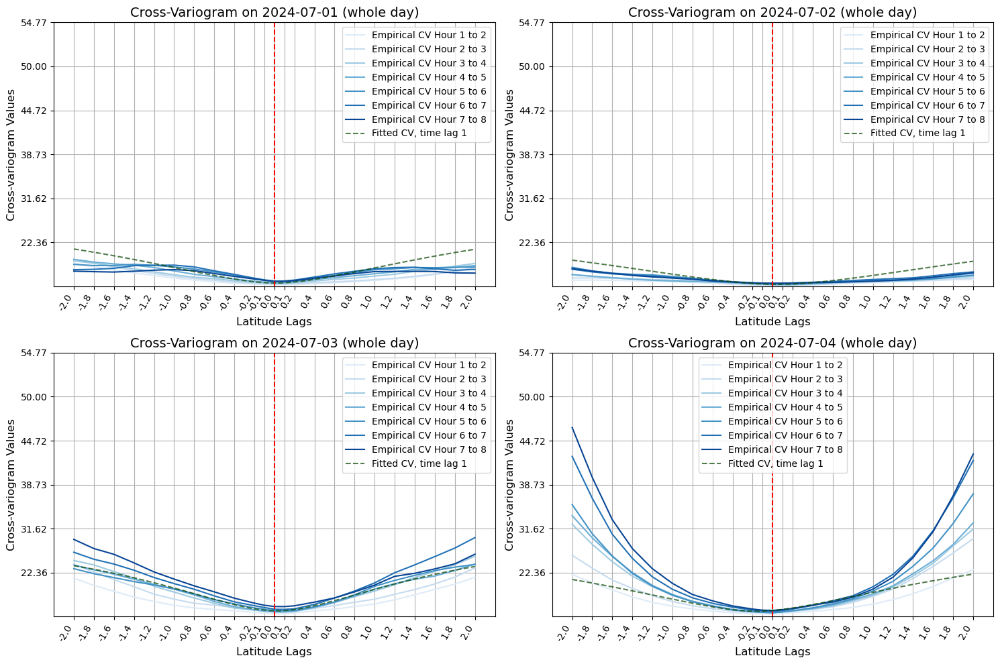

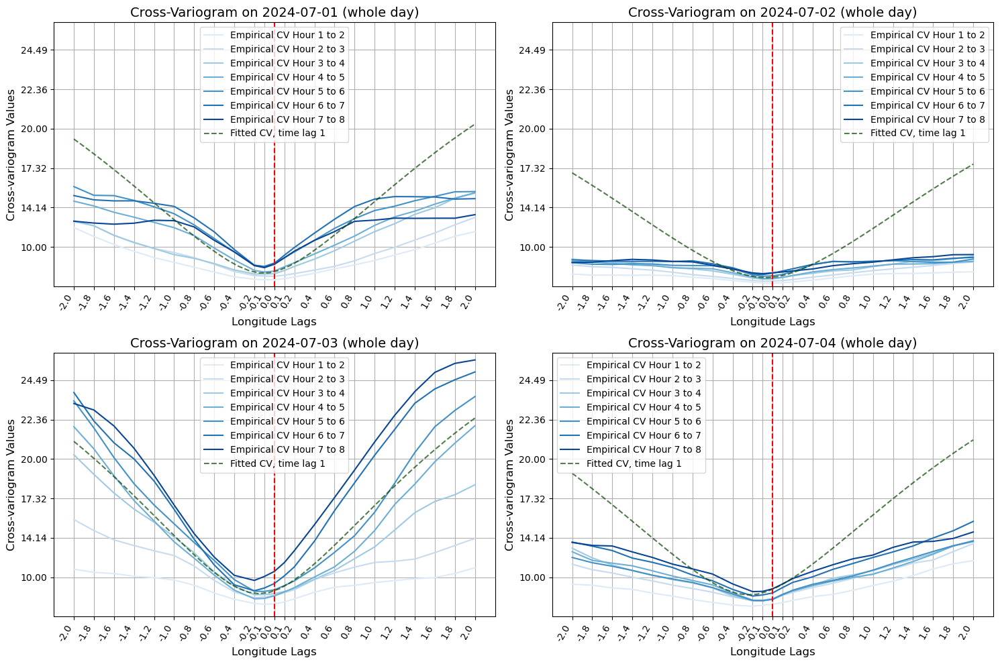

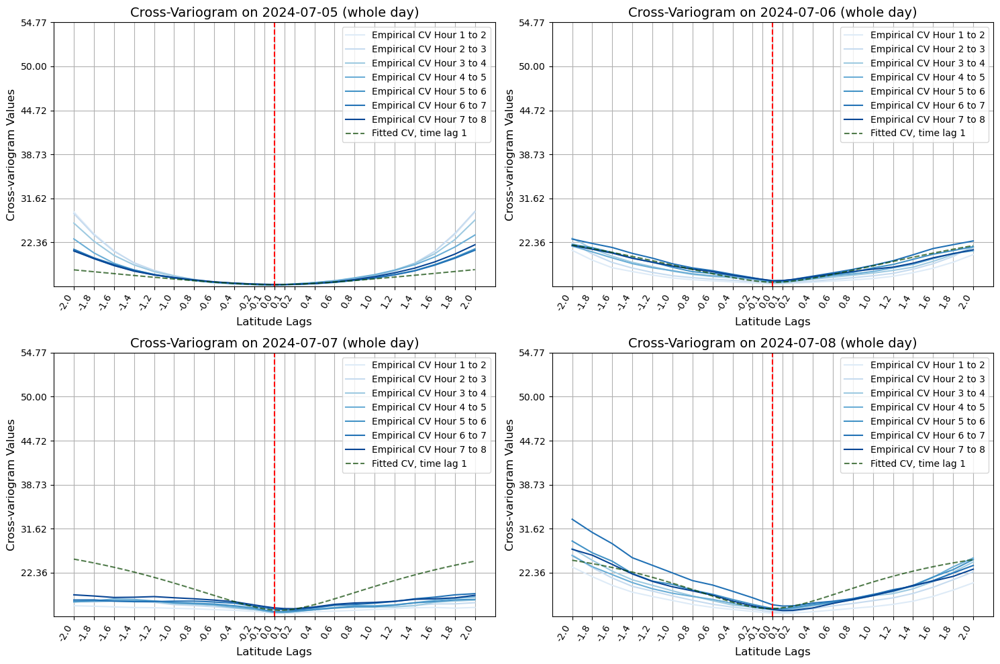

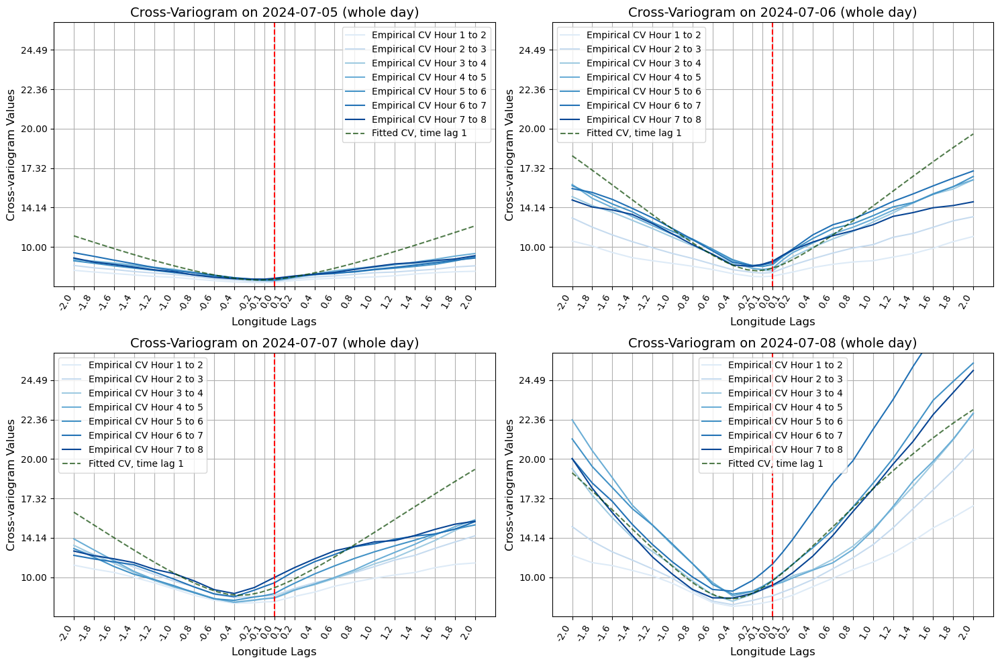

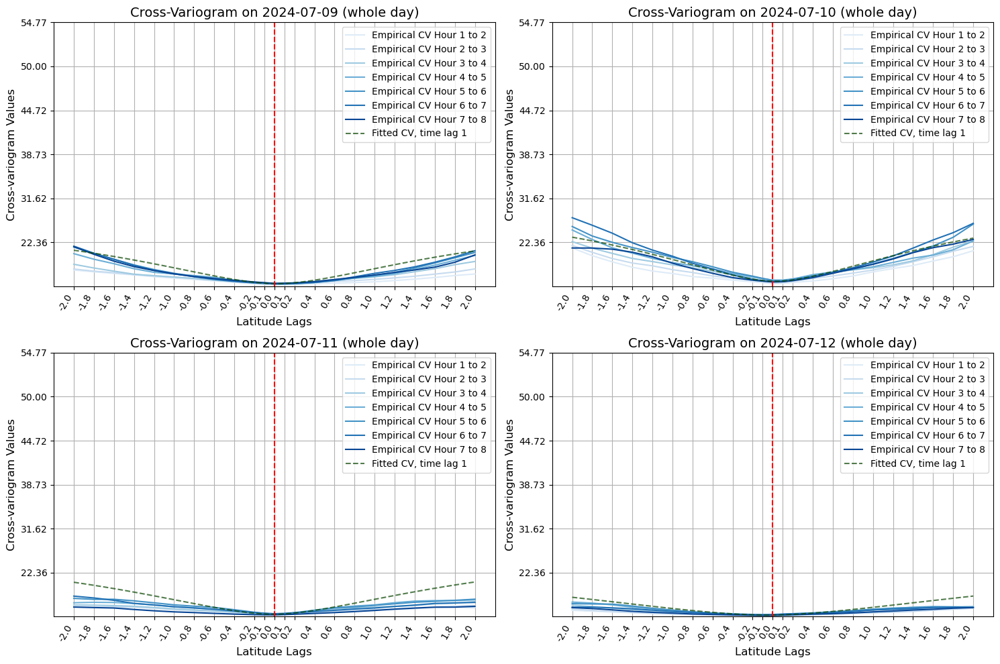

...

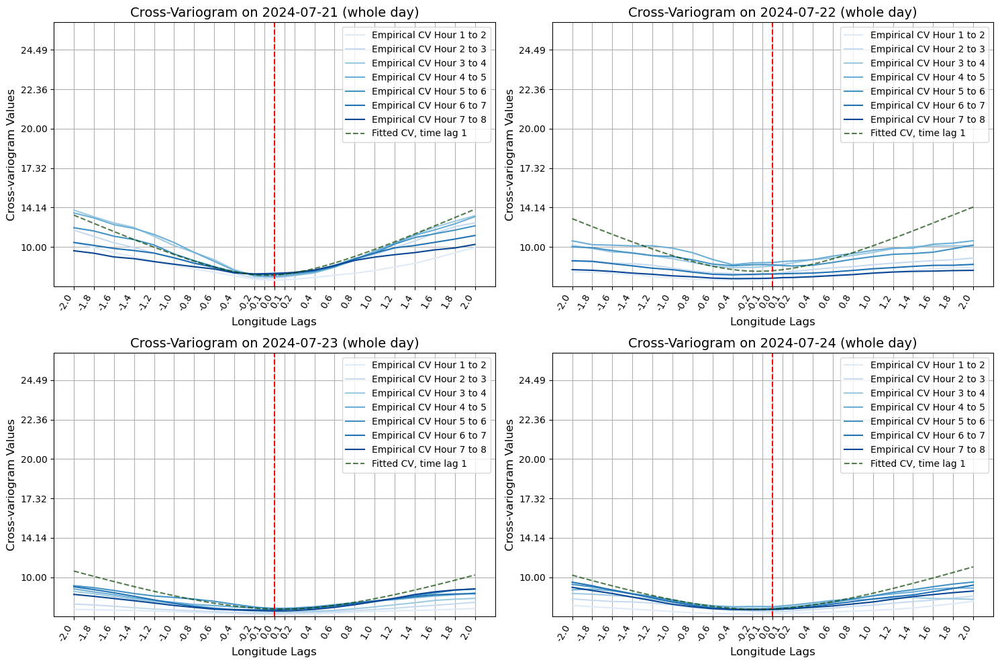

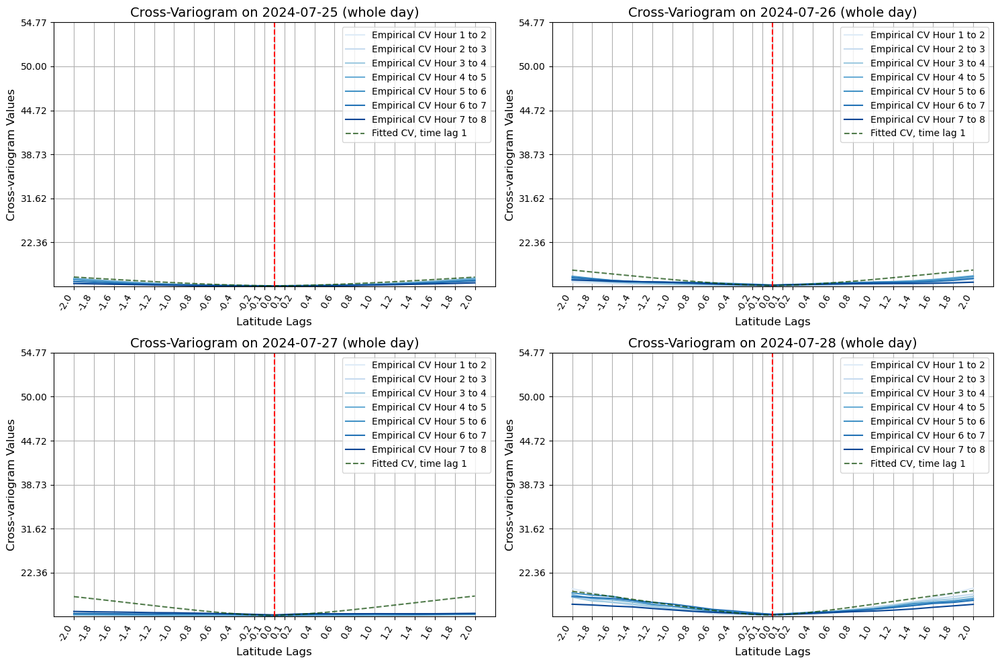

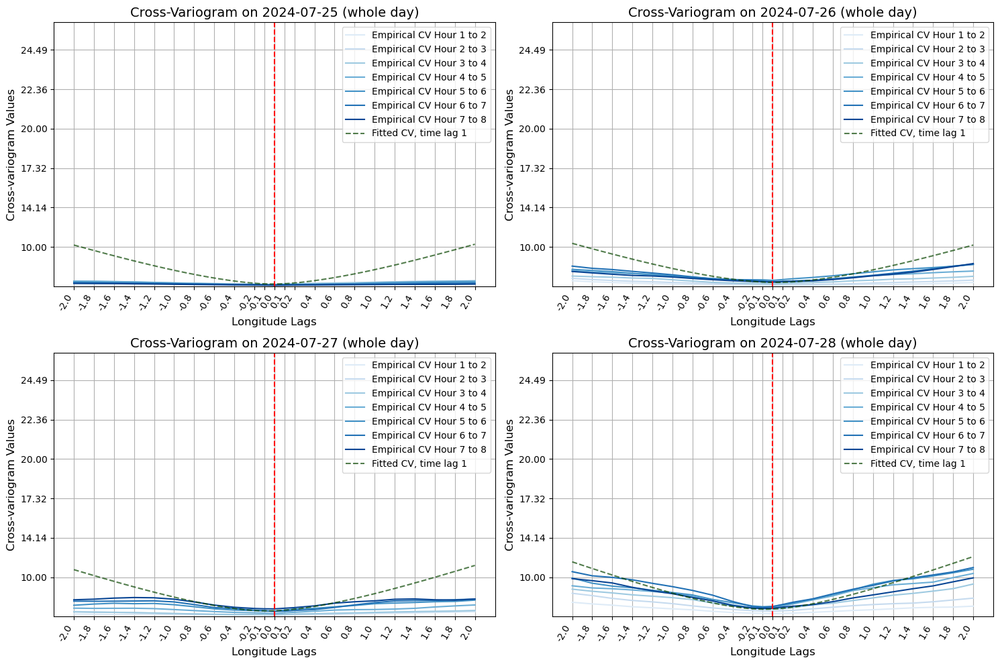

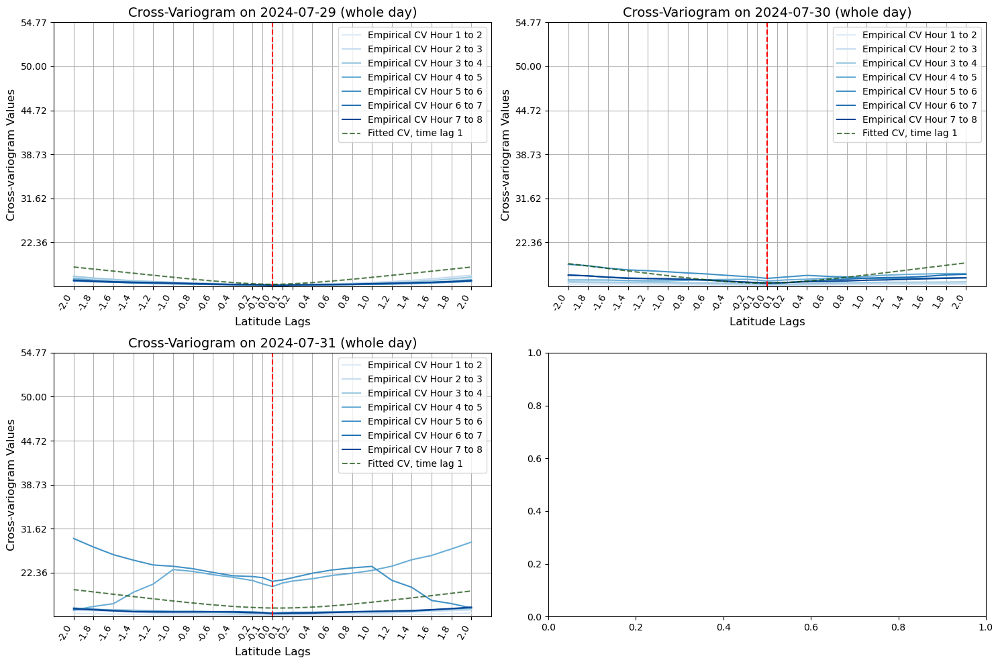

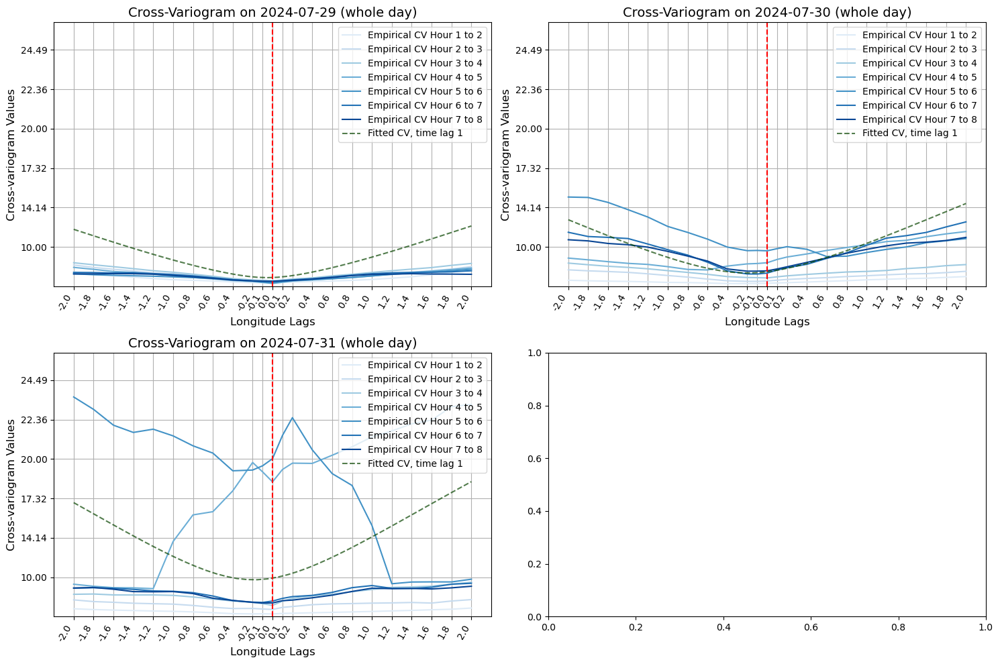

In [7]:
save_path = "C:\\Users\\joonw\\tco\\GEMS_TCO-2\\plots\\directional_semivariograms\\tmp_save"
length_of_analysis = 'whole day'
instance_sem = CrossVariogram(save_path, length_of_analysis)

# x_values = [-1, -.8, -.6, -.4, -.2, 0, 0.2, 0.4, 0.6, 0.8, 1]
dayss = [[1,2,3,4], [5,6,7,8], [9,10,11,12], [13,14,15,16], [17,18,19,20], [21,22,23,24], [25,26,27,28], [29,30,31]]
x_values = np.concatenate((np.linspace(-2, -0.2, 10), [-0.1, 0, 0.1], np.linspace(0.2, 2, 10)))

# dayss = [[1,2]]

for days in dayss:

    tmp = np.concatenate((np.linspace(-2, -0.2, 10), [-0.1, 0, 0.1], np.linspace(0.2, 2, 10)))
    tolerance = 0.02

    # latitude direction
    deltas = [ (round(a,1),0 ) for a in tmp]
    instance_sem.plot_lat_emp_the( d_lat_20000,days,deltas, df_1250)

    # longitude direction
    deltas = [ (0, round(a,1)) for a in tmp]
    instance_sem.plot_lon_emp_the( d_lon_20000,days,deltas, df_1250)

# full day but v15

load estimates first

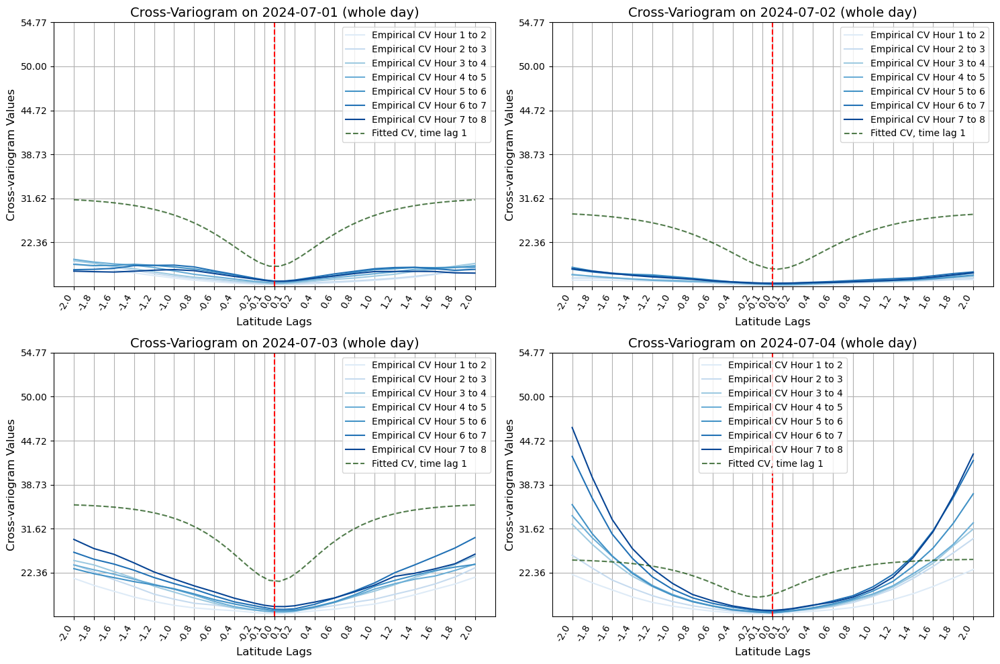

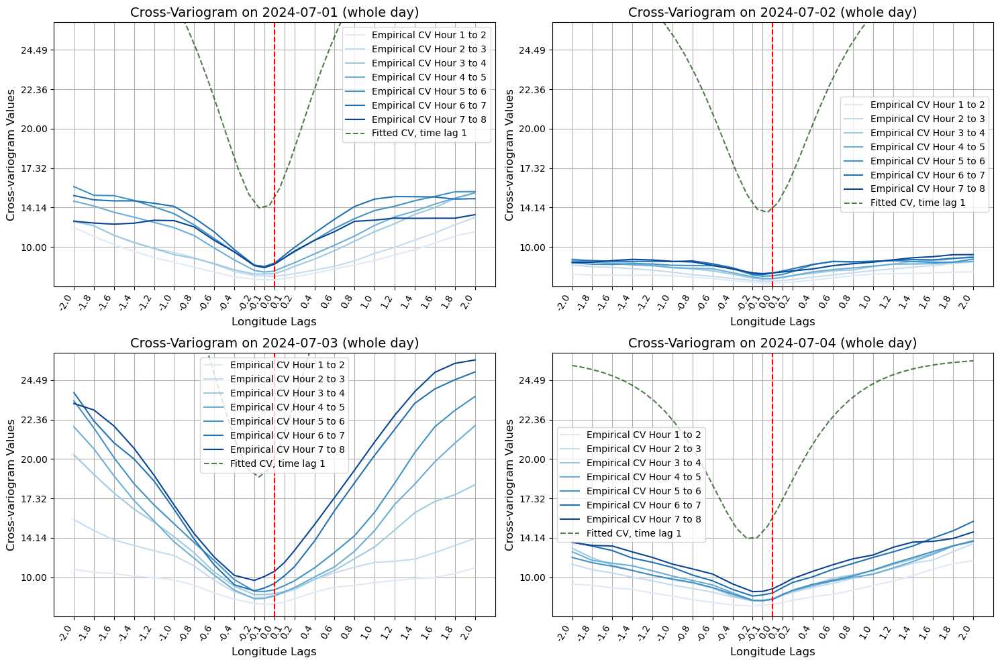

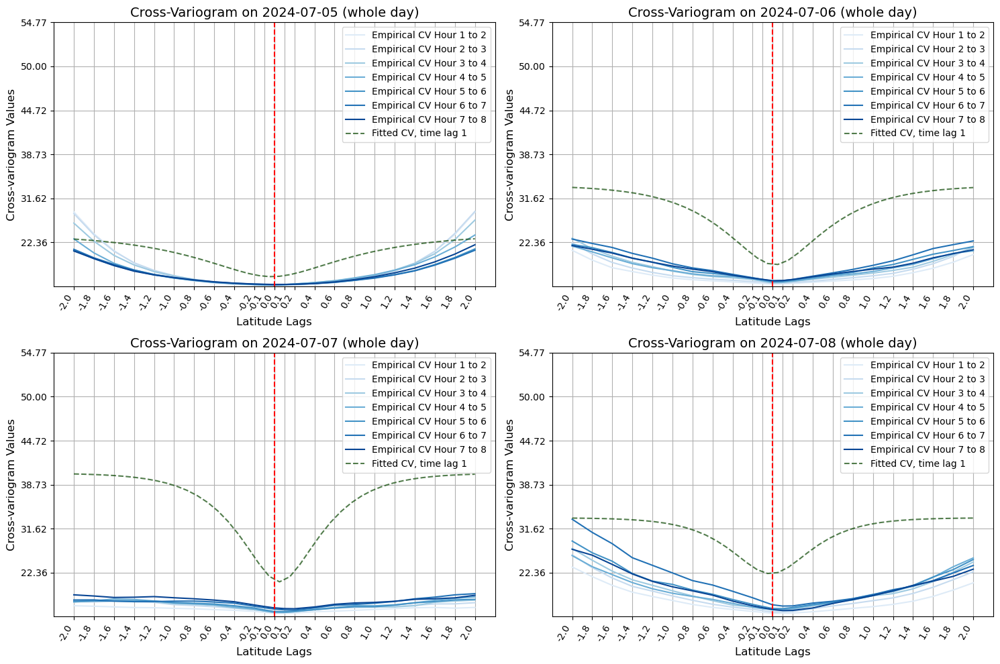

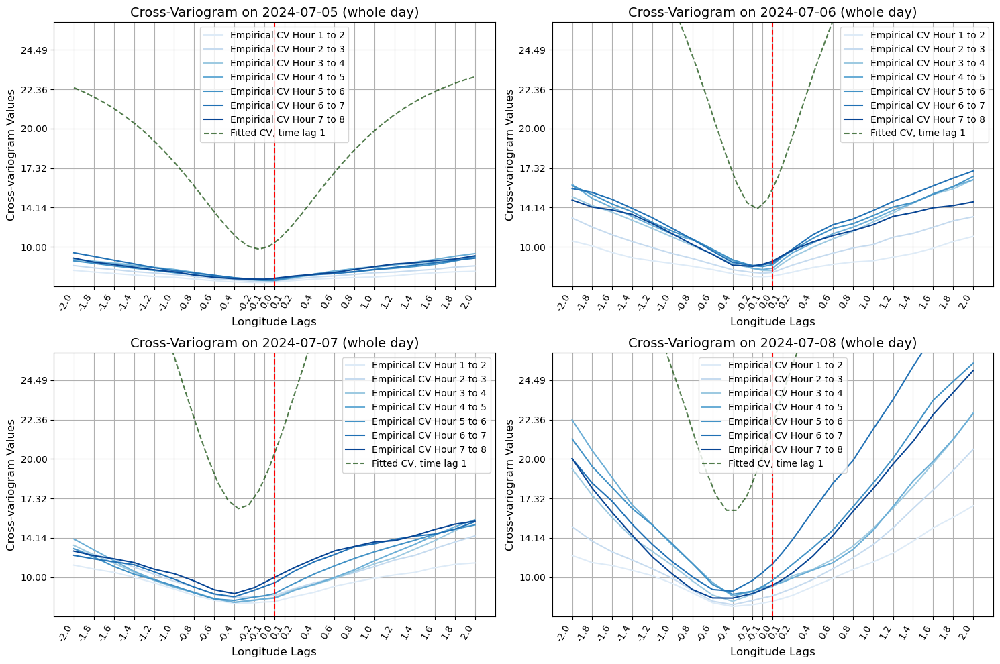

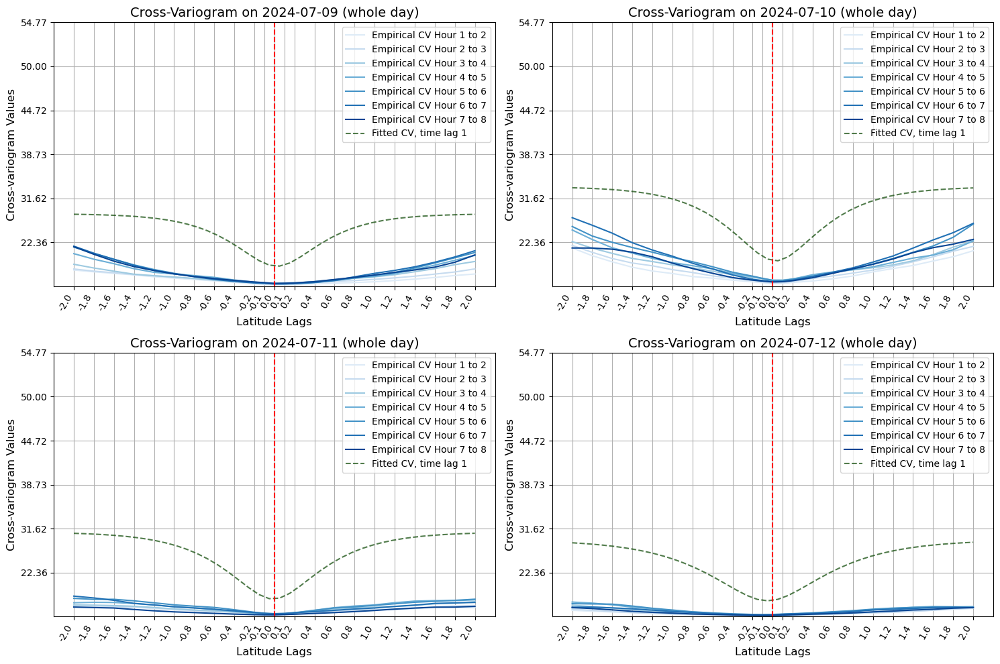

...

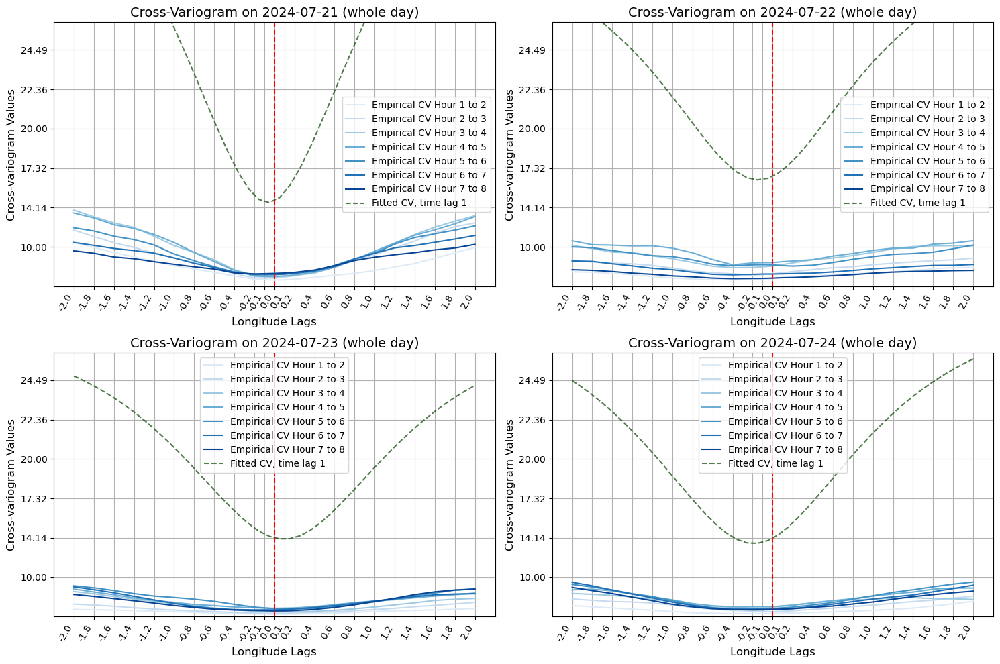

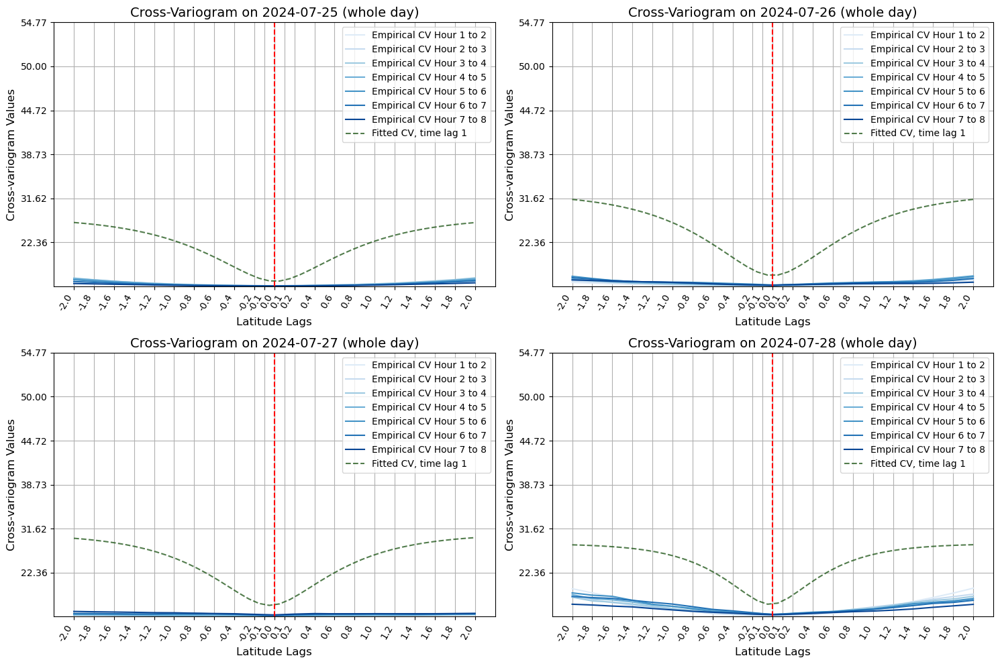

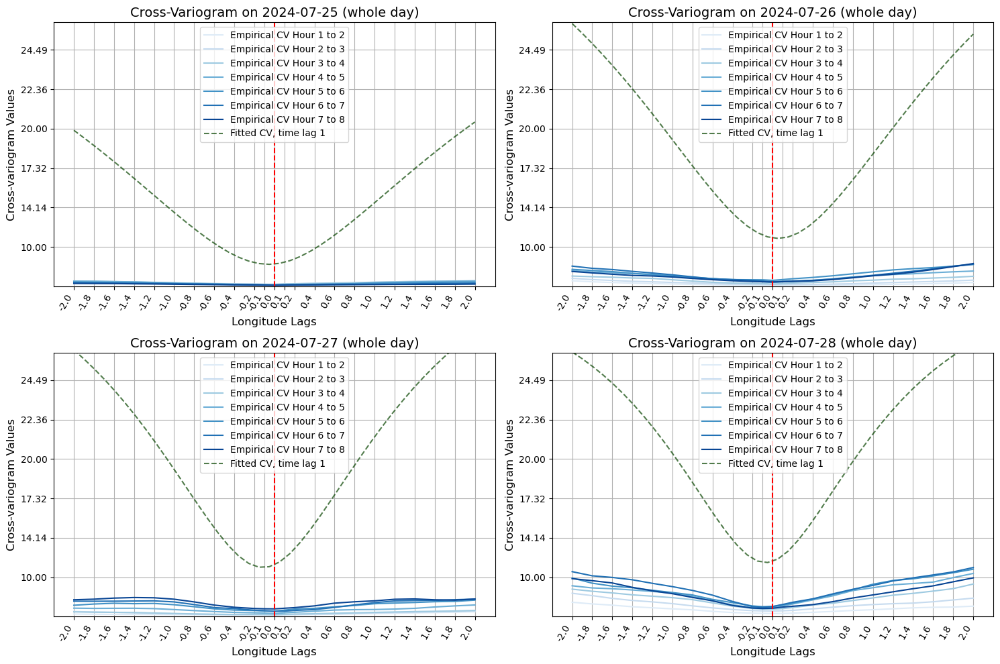

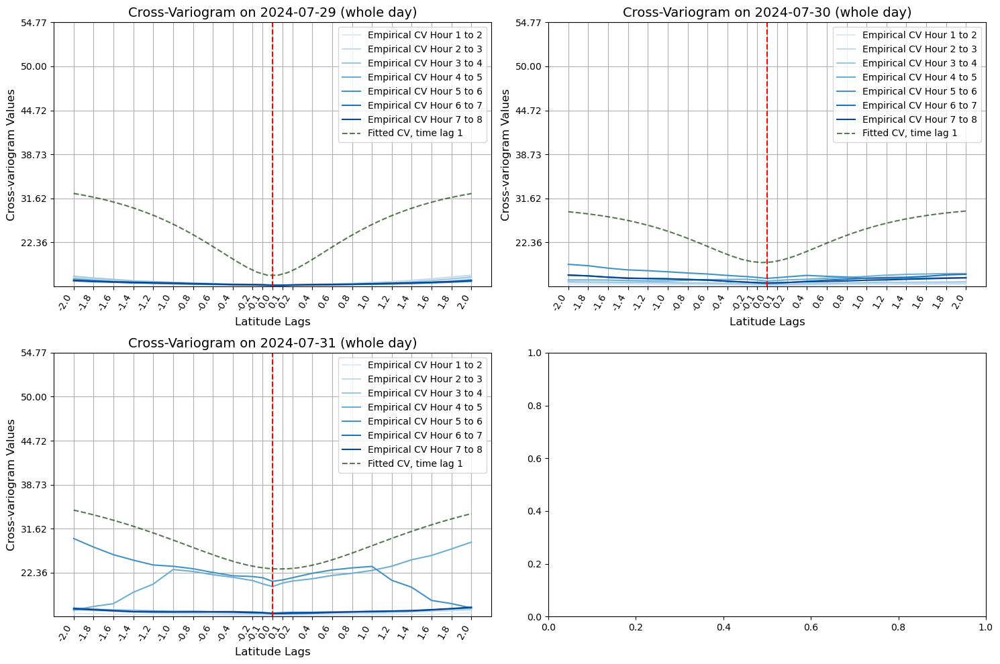

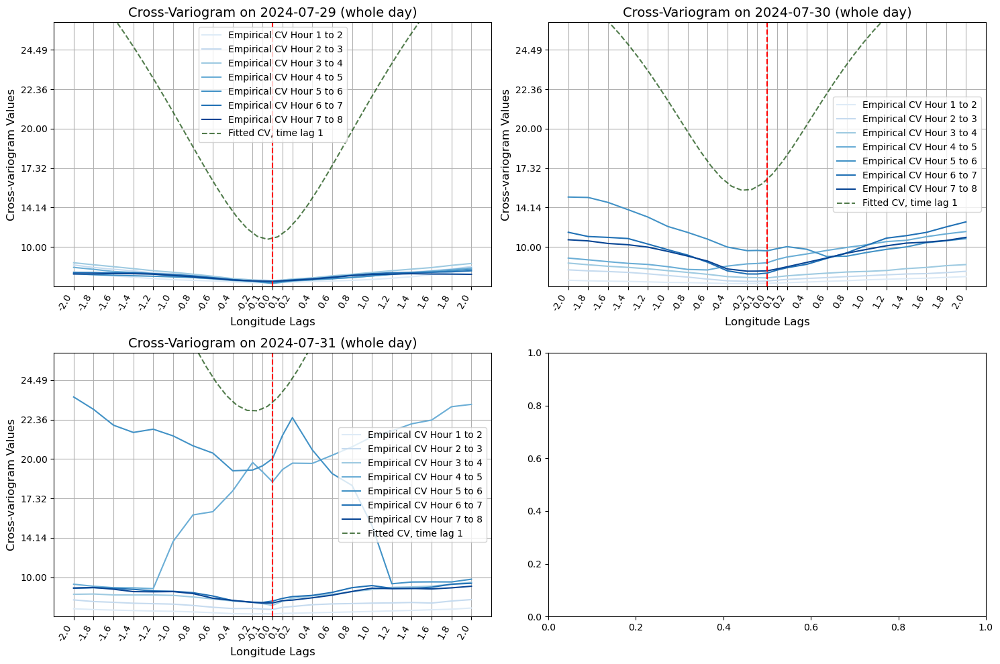

In [ ]:
dfv15_1250 = pd.read_csv("C:\\Users\\joonw\\tco\\GEMS_TCO-2\\Exercises\\from_amarel\\full_v15_1250.0.csv")

dfv15_1250.columns
dfv15_1250 = dfv15_1250[['sigma', 'range_lat', 'range_lon', 'advec_lat', 'advec_lon', 'beta', 'nugget', 'loss']]

save_path = "C:\\Users\\joonw\\tco\\GEMS_TCO-2\\plots\\directional_semivariograms\\tmp_save"
length_of_analysis = 'whole day'
instance_sem = CrossVariogram(save_path, length_of_analysis)

# x_values = [-1, -.8, -.6, -.4, -.2, 0, 0.2, 0.4, 0.6, 0.8, 1]
dayss = [[1,2,3,4], [5,6,7,8], [9,10,11,12], [13,14,15,16], [17,18,19,20], [21,22,23,24], [25,26,27,28], [29,30,31]]
x_values = np.concatenate((np.linspace(-2, -0.2, 10), [-0.1, 0, 0.1], np.linspace(0.2, 2, 10)))

# dayss = [[1,2]]

for days in dayss:

    tmp = np.concatenate((np.linspace(-2, -0.2, 10), [-0.1, 0, 0.1], np.linspace(0.2, 2, 10)))
    tolerance = 0.02

    # latitude direction
    deltas = [ (round(a,1),0 ) for a in tmp]
    instance_sem.plot_lat_emp_the( d_lat_20000,days,deltas, dfv15_1250)

    # longitude direction
    deltas = [ (0, round(a,1)) for a in tmp]
    instance_sem.plot_lon_emp_the( d_lon_20000,days,deltas, dfv15_1250)

# v10

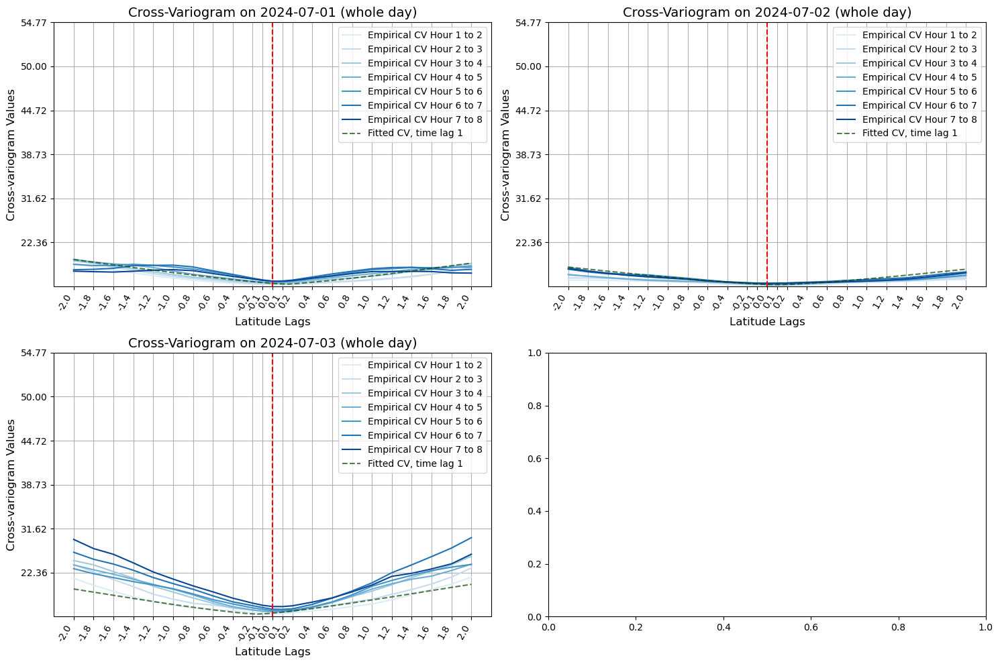

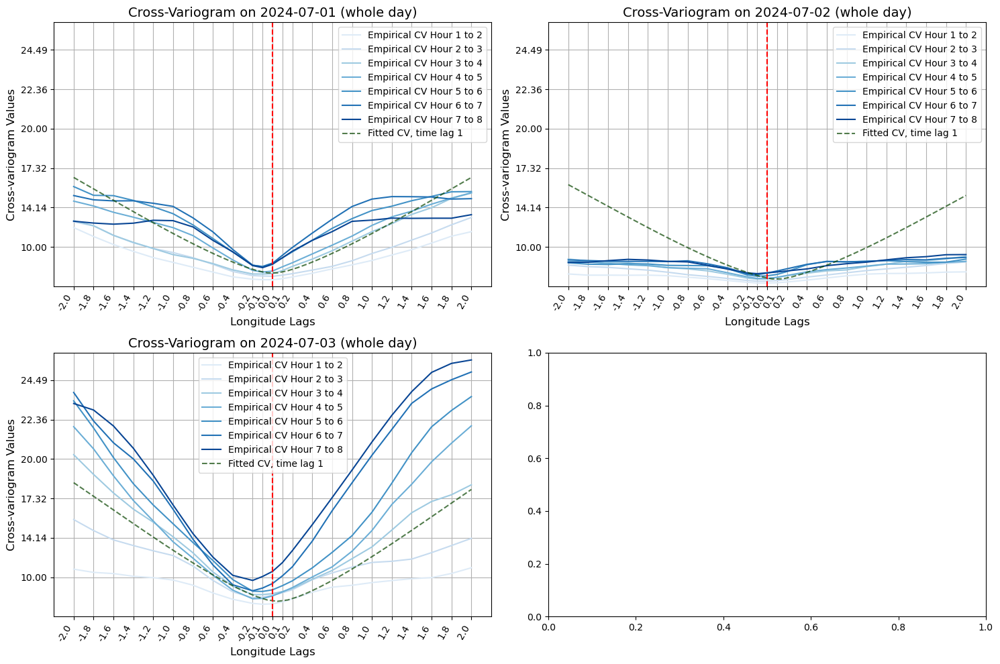

In [21]:
dfv10_1250 = pd.read_csv("C:\\Users\\joonw\\tco\\GEMS_TCO-2\\Exercises\\from_amarel\\full_v10_1250.0.csv")

dfv10_1250.columns
dfv10_1250 = dfv10_1250[['sigma', 'range_lat', 'range_lon', 'advec_lat', 'advec_lon', 'beta', 'nugget', 'loss']]

save_path = "C:\\Users\\joonw\\tco\\GEMS_TCO-2\\plots\\directional_semivariograms\\tmp_save"
length_of_analysis = 'whole day'
instance_sem = CrossVariogram(save_path, length_of_analysis)

# x_values = [-1, -.8, -.6, -.4, -.2, 0, 0.2, 0.4, 0.6, 0.8, 1]
dayss = [[1,2,3,4], [5,6,7,8], [9,10,11,12], [13,14,15,16], [17,18,19,20], [21,22,23,24], [25,26,27,28], [29,30,31]]
x_values = np.concatenate((np.linspace(-2, -0.2, 10), [-0.1, 0, 0.1], np.linspace(0.2, 2, 10)))

dayss = [[1,2,3]]

for days in dayss:

    tmp = np.concatenate((np.linspace(-2, -0.2, 10), [-0.1, 0, 0.1], np.linspace(0.2, 2, 10)))
    tolerance = 0.02

    # latitude direction
    deltas = [ (round(a,1),0 ) for a in tmp]
    instance_sem.plot_lat_emp_the( d_lat_20000,days,deltas, dfv10_1250)

    # longitude direction
    deltas = [ (0, round(a,1)) for a in tmp]
    instance_sem.plot_lon_emp_the( d_lon_20000,days,deltas, dfv10_1250)

# halfday

In [ ]:
input_path = "C:\\Users\\joonw\\tco\\GEMS_TCO-2\\GEMS_TCO_EDA\\outputs"

# morning_v05_1250
input_filename = "full_morning_v0.5_estimation_1250_july24.pkl"
input_filepath = os.path.join(input_path, input_filename)
# Load pickle
with open(input_filepath, 'rb') as pickle_file:
    amarel_morning_v05_1250 = pickle.load(pickle_file)

# Assuming df_1250 is your DataFrame
morning_v05_1250 = pd.DataFrame()
for key in amarel_morning_v05_1250:
    # tmp = pd.DataFrame(amarel_map1250[key][0].reshape(1, -1), columns=['sigmasq', 'range_lat', 'range_lon', 'advec_lat', 'advec_lon', 'beta', 'nugget'])

    tmp = pd.DataFrame( np.array(amarel_morning_v05_1250[key][0][:-1]).reshape(1,-1), columns=['sigmasq', 'range_lat', 'range_lon', 'advec_lat', 'advec_lon', 'beta', 'nugget'])
    # tmp['loss'] = amarel_map1250[key][1]
    tmp['loss'] = amarel_morning_v05_1250[key][0][-1]
    morning_v05_1250 = pd.concat((morning_v05_1250, tmp), axis=0)

# Generate date range
date_range = pd.date_range(start='07-01-24', end='07-31-24')

# Ensure the number of dates matches the number of rows in df_1250
if len(date_range) == len(morning_v05_1250):
    morning_v05_1250.index = date_range
else:
    print("The number of dates does not match the number of rows in the DataFrame.")

 
# noon_v05_1250 
input_filename = "full_noon_v0.5_estimation_1250_july24.pkl"
input_filepath = os.path.join(input_path, input_filename)
# Load pickle
with open(input_filepath, 'rb') as pickle_file:
    amarel_noon_v05_1250 = pickle.load(pickle_file)

# Assuming df_1250 is your DataFrame
noon_v05_1250 = pd.DataFrame()
for key in amarel_noon_v05_1250:
    # tmp = pd.DataFrame(amarel_map1250[key][0].reshape(1, -1), columns=['sigmasq', 'range_lat', 'range_lon', 'advec_lat', 'advec_lon', 'beta', 'nugget'])

  
    tmp = pd.DataFrame( np.array(amarel_noon_v05_1250[key][0][:-1]).reshape(1,-1), columns=['sigmasq', 'range_lat', 'range_lon', 'advec_lat', 'advec_lon', 'beta', 'nugget'])
    # tmp['loss'] = amarel_map1250[key][1]
    tmp['loss'] = amarel_noon_v05_1250[key][0][-1]
    noon_v05_1250 = pd.concat((noon_v05_1250, tmp), axis=0)

# Generate date range
date_range = pd.date_range(start='07-01-24', end='07-31-24')

# Ensure the number of dates matches the number of rows in df_1250
if len(date_range) == len(noon_v05_1250):
    noon_v05_1250.index = date_range
else:
    print("The number of dates does not match the number of rows in the DataFrame.")


In [7]:
input_path = "C:\\Users\\joonw\\tco\\GEMS_TCO-2\\GEMS_TCO_EDA\\outputs"

# morning_v05_1250
input_filename = "full_morning_v1.5_estimation_1250_july24.pkl"
input_filepath = os.path.join(input_path, input_filename)
# Load pickle
with open(input_filepath, 'rb') as pickle_file:
    amarel_morning_v15_1250 = pickle.load(pickle_file)

# Assuming df_1250 is your DataFrame
morning_v15_1250 = pd.DataFrame()
for key in amarel_morning_v15_1250:
    # tmp = pd.DataFrame(amarel_map1250[key][0].reshape(1, -1), columns=['sigmasq', 'range_lat', 'range_lon', 'advec_lat', 'advec_lon', 'beta', 'nugget'])

    tmp = pd.DataFrame( np.array(amarel_morning_v15_1250[key][0][:-1]).reshape(1,-1), columns=['sigmasq', 'range_lat', 'range_lon', 'advec_lat', 'advec_lon', 'beta', 'nugget'])
    # tmp['loss'] = amarel_map1250[key][1]
    tmp['loss'] = amarel_morning_v15_1250[key][0][-1]
    morning_v15_1250 = pd.concat((morning_v15_1250, tmp), axis=0)

# Generate date range
date_range = pd.date_range(start='07-01-24', end='07-31-24')

# Ensure the number of dates matches the number of rows in df_1250
if len(date_range) == len(morning_v15_1250):
    morning_v15_1250.index = date_range
else:
    print("The number of dates does not match the number of rows in the DataFrame.")

 


# noon_v05_1250 
input_filename = "full_noon_v1.5_estimation_1250_july24.pkl"
input_filepath = os.path.join(input_path, input_filename)
# Load pickle
with open(input_filepath, 'rb') as pickle_file:
    amarel_noon_v15_1250 = pickle.load(pickle_file)

# Assuming df_1250 is your DataFrame
noon_v15_1250 = pd.DataFrame()
for key in amarel_noon_v15_1250:
    # tmp = pd.DataFrame(amarel_map1250[key][0].reshape(1, -1), columns=['sigmasq', 'range_lat', 'range_lon', 'advec_lat', 'advec_lon', 'beta', 'nugget'])

  
    tmp = pd.DataFrame( np.array(amarel_noon_v15_1250[key][0][:-1]).reshape(1,-1), columns=['sigmasq', 'range_lat', 'range_lon', 'advec_lat', 'advec_lon', 'beta', 'nugget'])
    # tmp['loss'] = amarel_map1250[key][1]
    tmp['loss'] = amarel_noon_v15_1250[key][0][-1]
    noon_v15_1250 = pd.concat((noon_v15_1250, tmp), axis=0)

# Generate date range
date_range = pd.date_range(start='07-01-24', end='07-31-24')

# Ensure the number of dates matches the number of rows in df_1250
if len(date_range) == len(noon_v15_1250):
    noon_v15_1250.index = date_range
else:
    print("The number of dates does not match the number of rows in the DataFrame.")


# plot

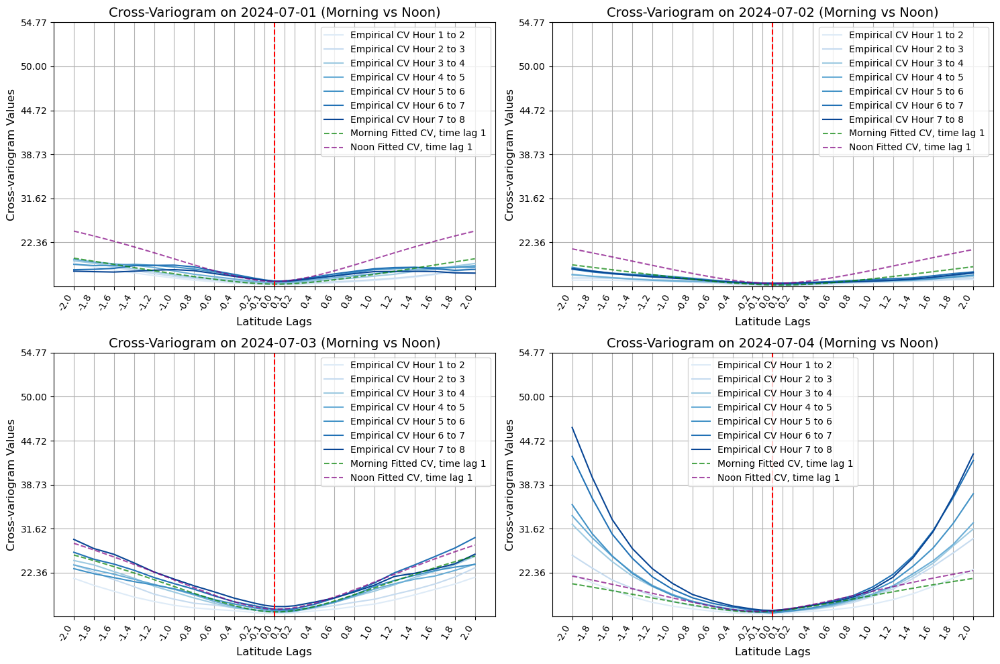

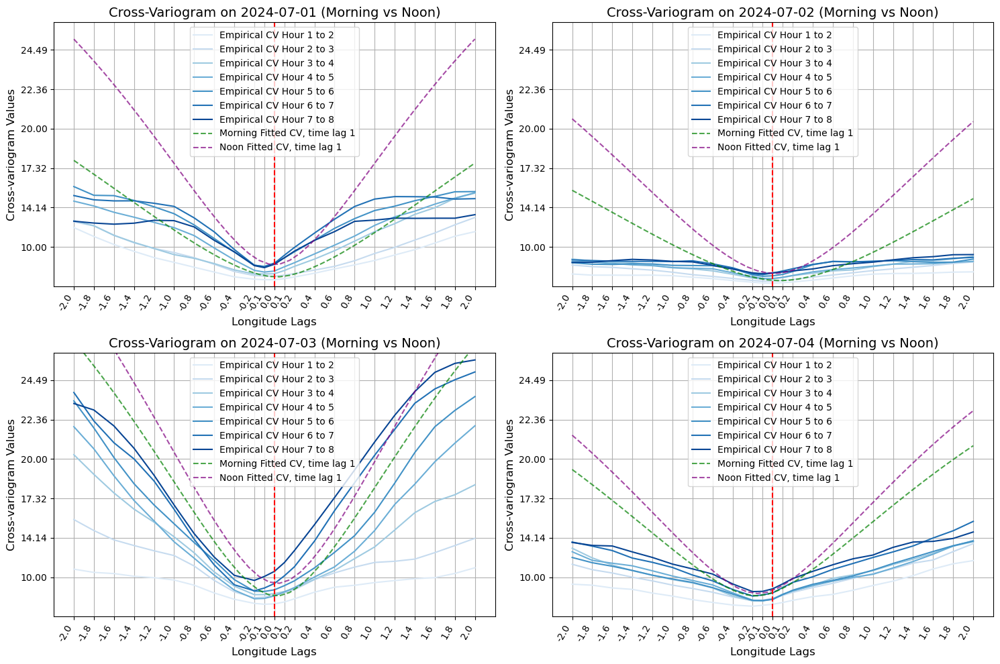

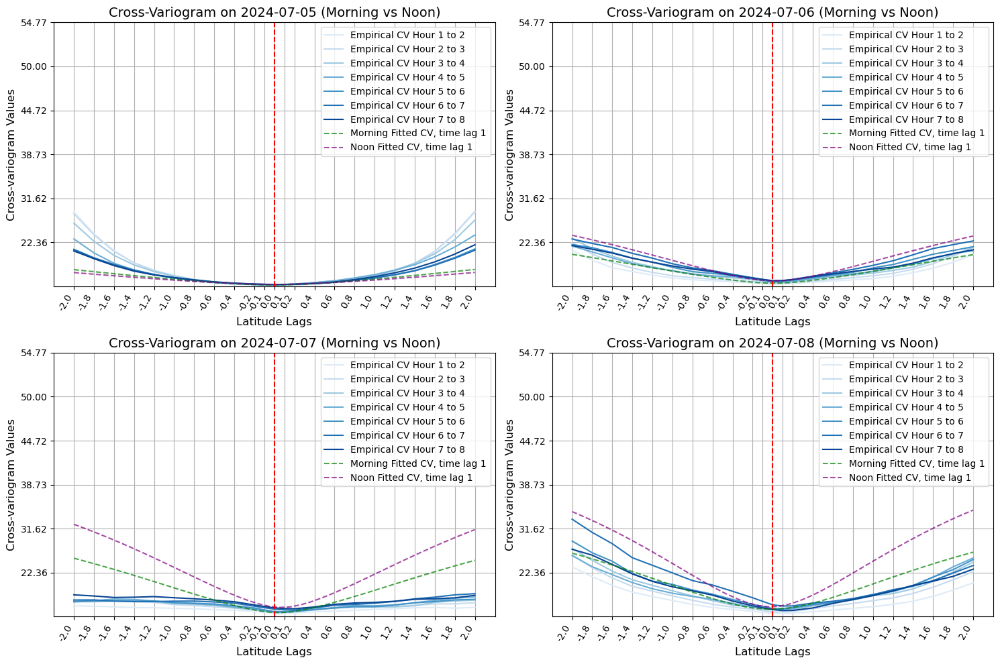

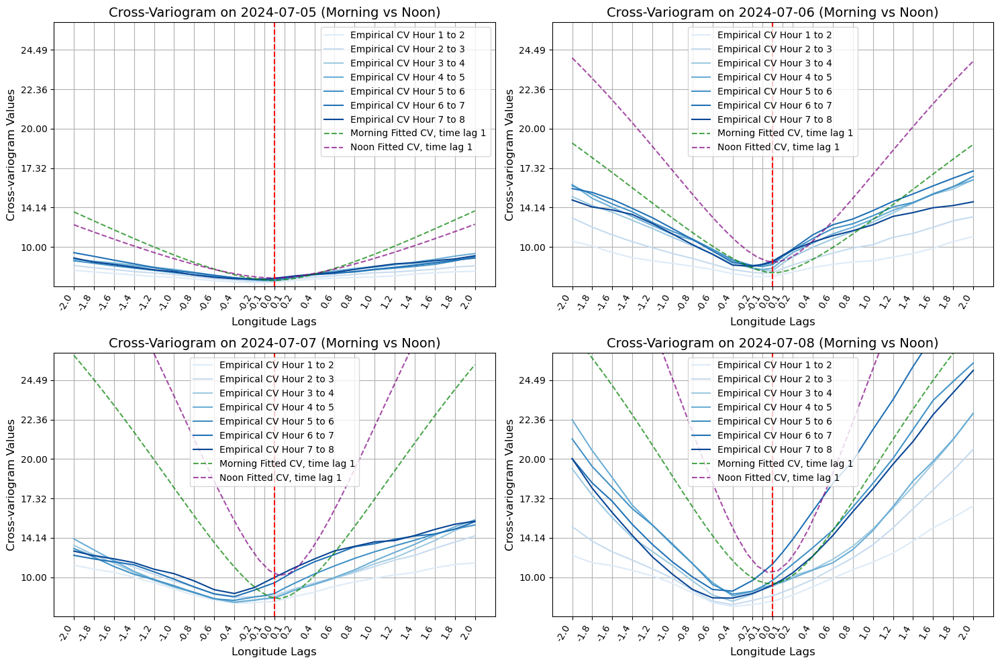

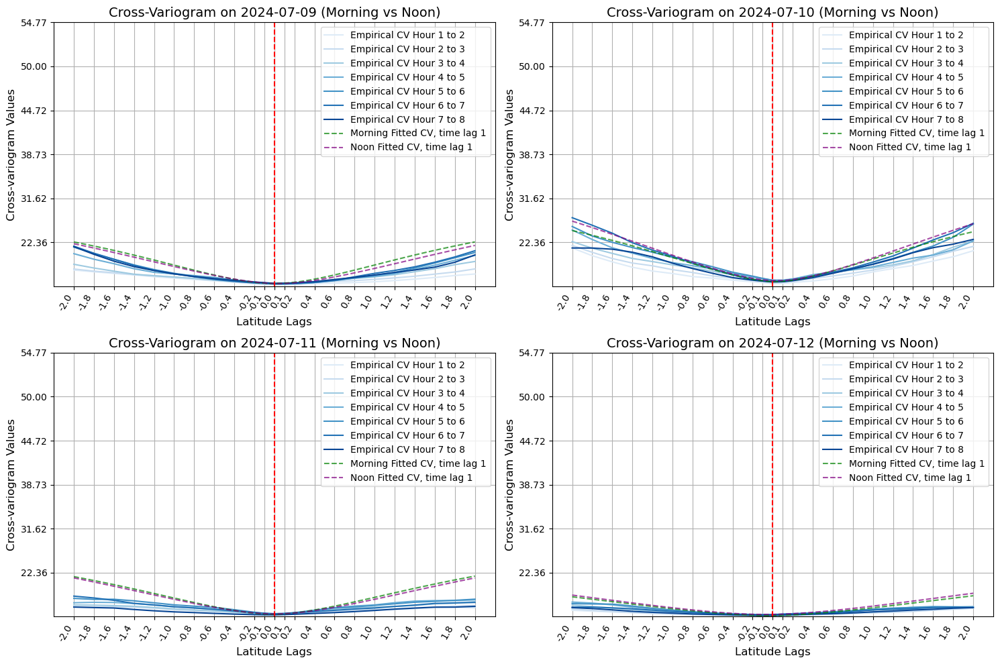

...

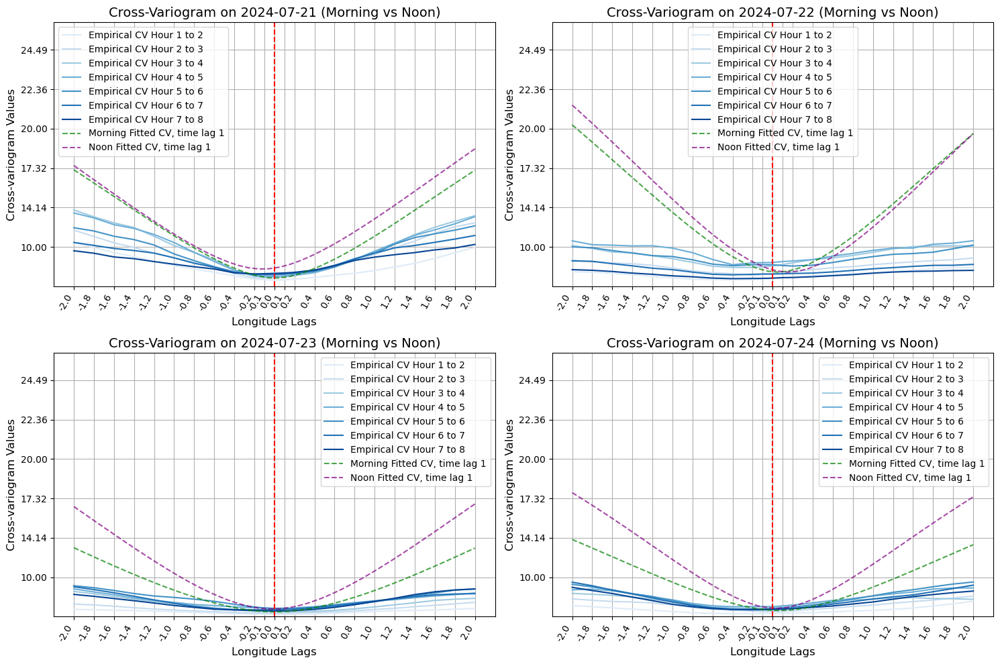

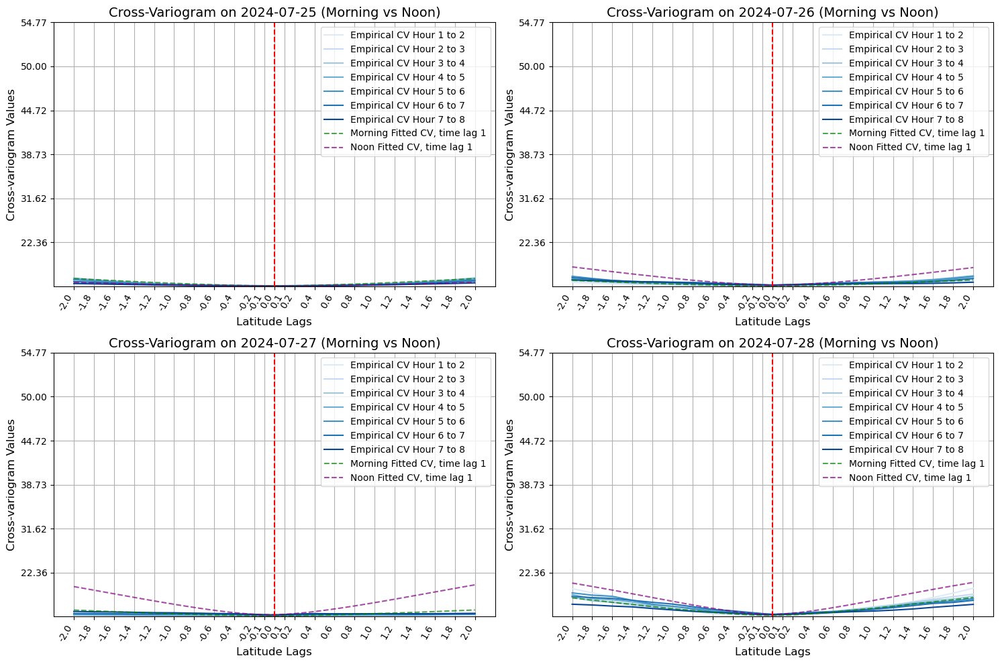

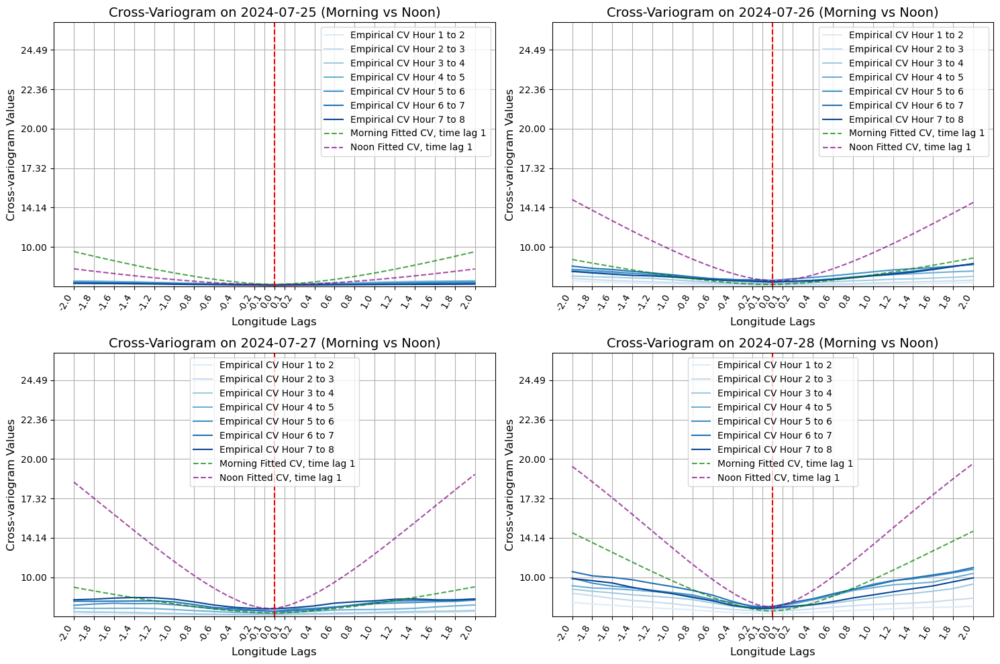

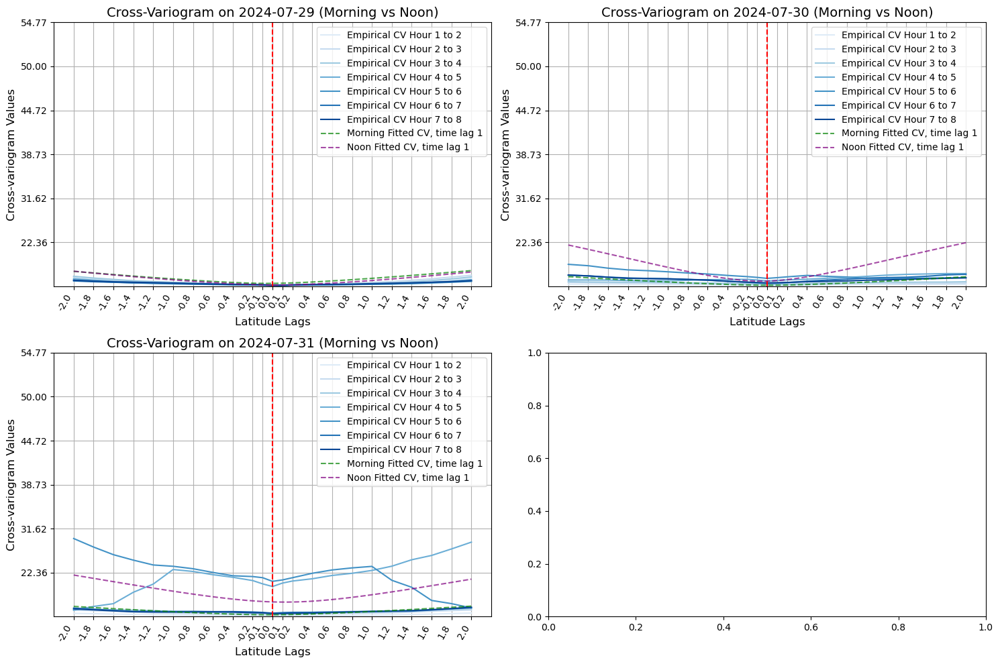

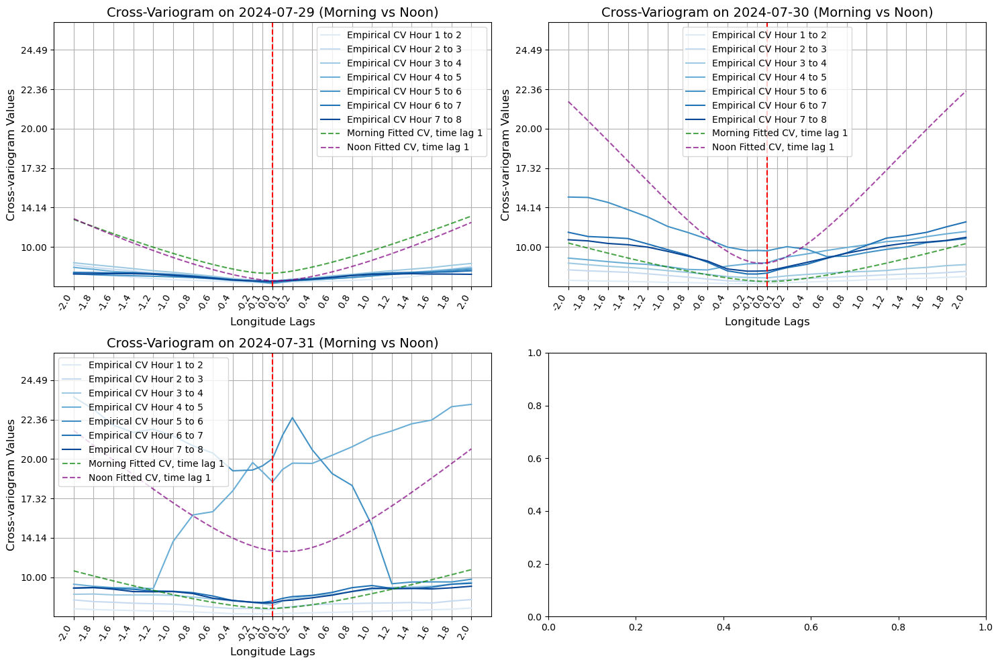

In [28]:
save_path = "C:\\Users\\joonw\\tco\\GEMS_TCO-2\\plots\\directional_semivariograms\\tmp_save"


length_of_analysis = 'Morning vs Noon'
instance_sem = CrossVariogram(save_path, length_of_analysis)

# x_values = [-1, -.8, -.6, -.4, -.2, 0, 0.2, 0.4, 0.6, 0.8, 1]
dayss = [[1,2,3,4], [5,6,7,8], [9,10,11,12], [13,14,15,16], [17,18,19,20], [21,22,23,24], [25,26,27,28], [29,30,31]]
x_values = np.concatenate((np.linspace(-2, -0.2, 10), [-0.1, 0, 0.1], np.linspace(0.2, 2, 10)))

# dayss = [[1,2]]

for days in dayss:

    tmp = np.concatenate((np.linspace(-2, -0.2, 10), [-0.1, 0, 0.1], np.linspace(0.2, 2, 10)))
    tolerance = 0.02

    # latitude direction
    deltas = [ (round(a,1),0 ) for a in tmp]
    instance_sem.plot_two_latitude(days, d_lat_20000, deltas, morning_v05_1250, noon_v05_1250)

    # longitude direction
    deltas_lon = [ (0, round(a,1)) for a in tmp]
    instance_sem.plot_two_longitude(days, d_lon_20000, deltas_lon, morning_v05_1250, noon_v05_1250)
 

halfday v15

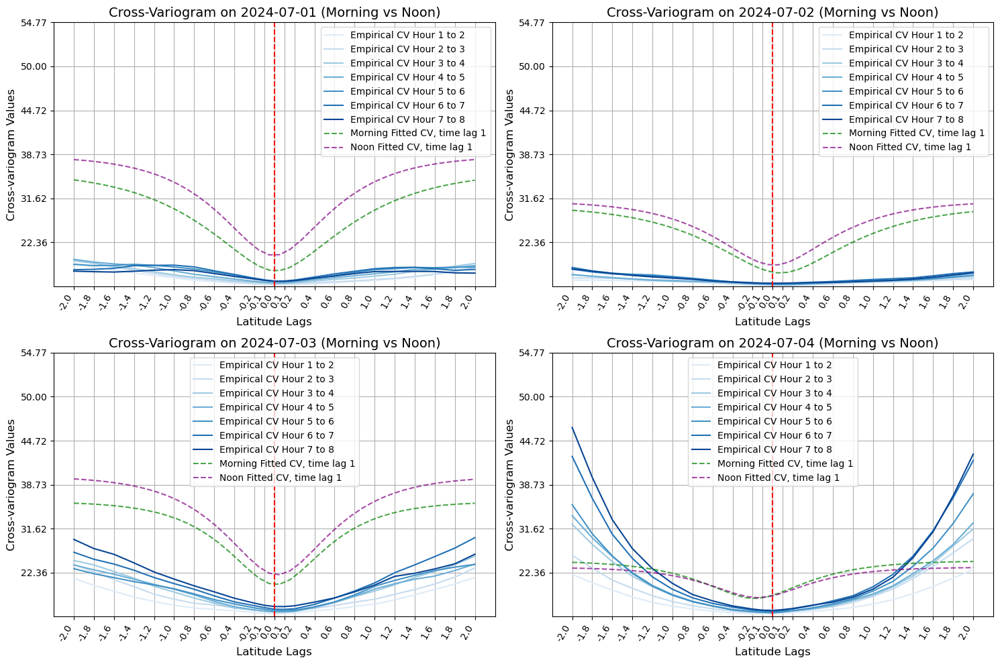

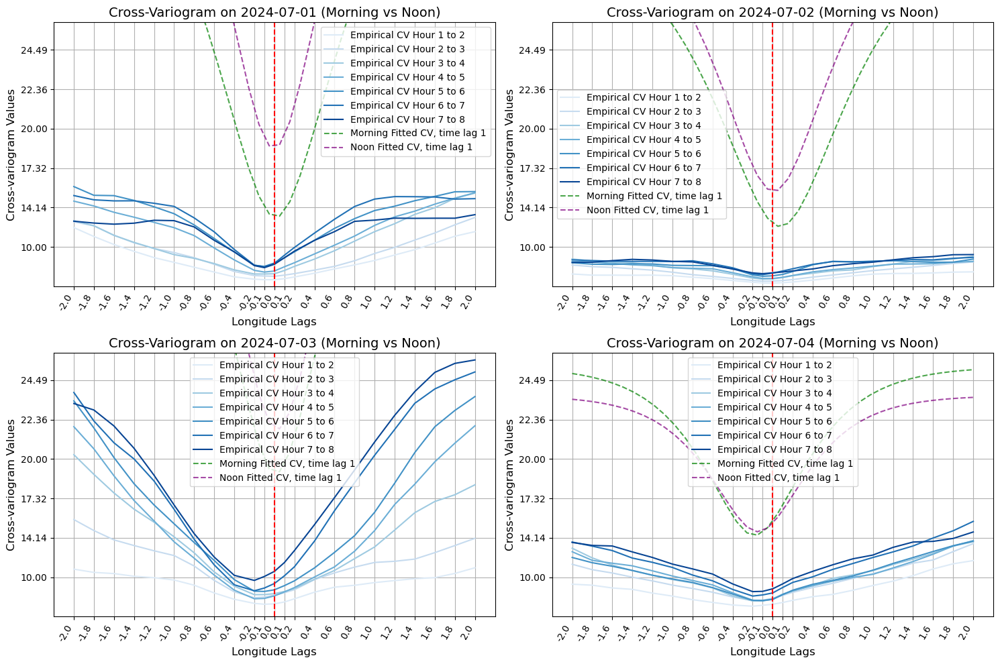

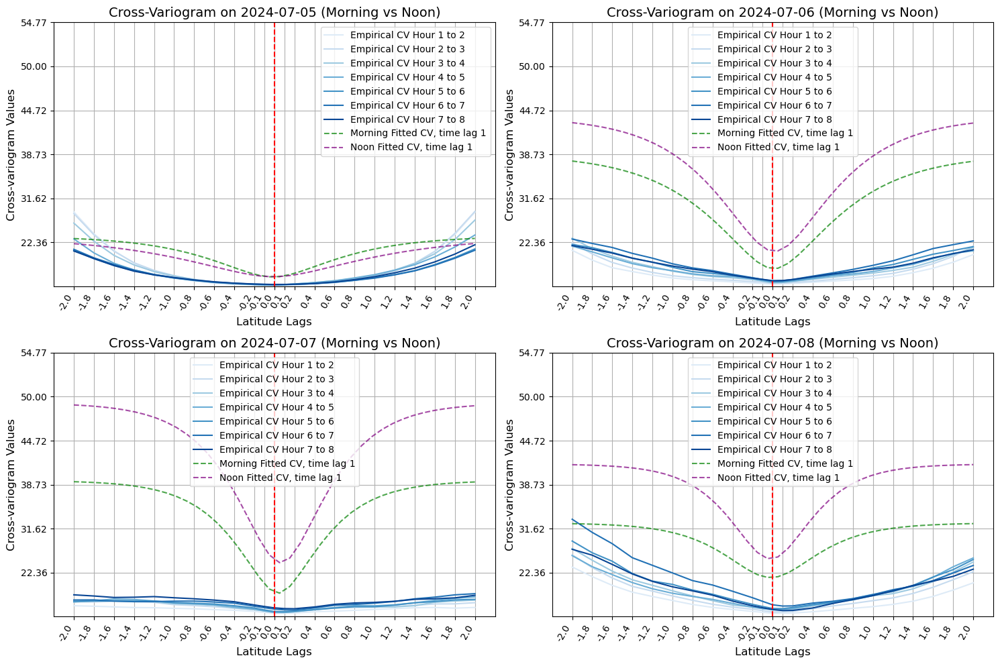

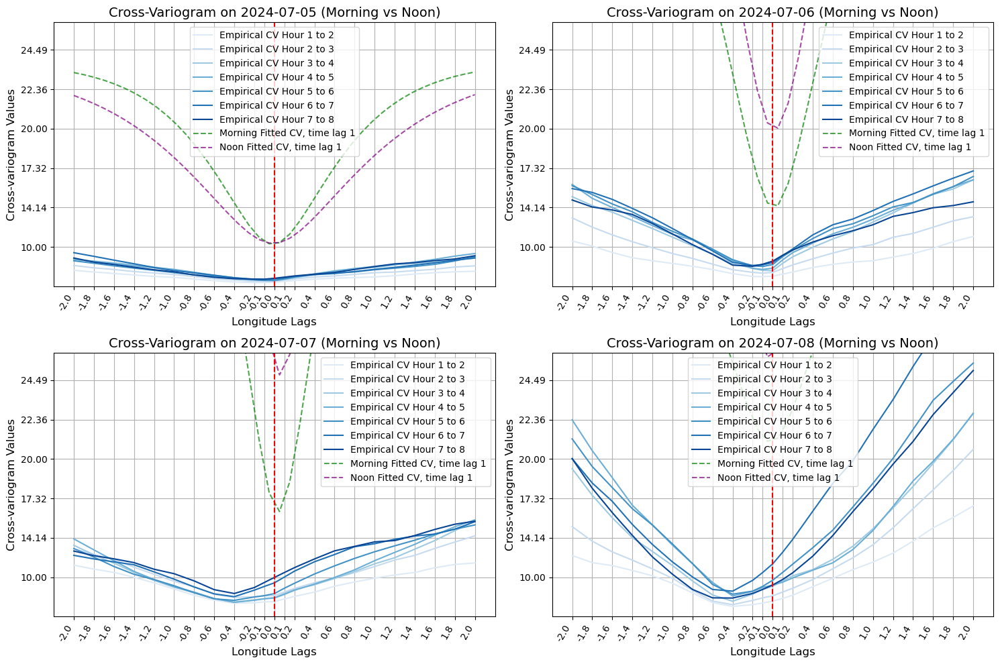

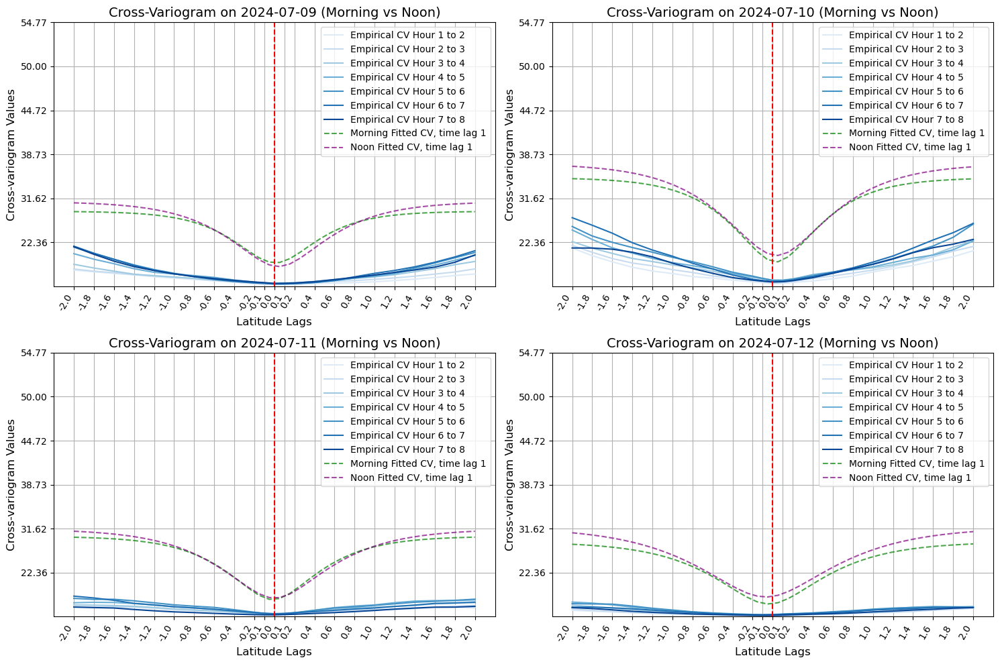

...

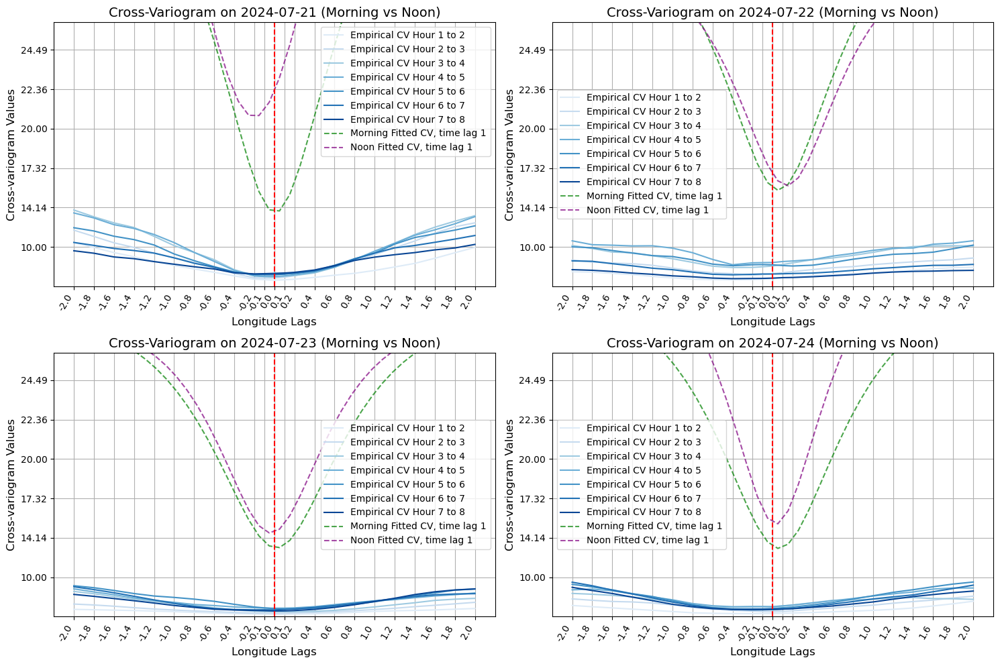

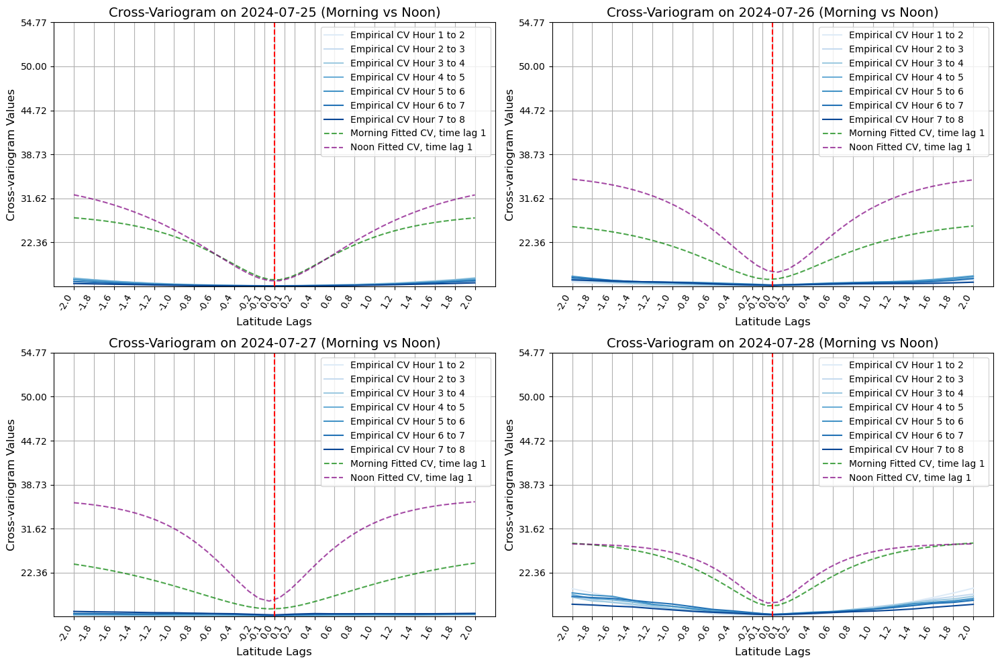

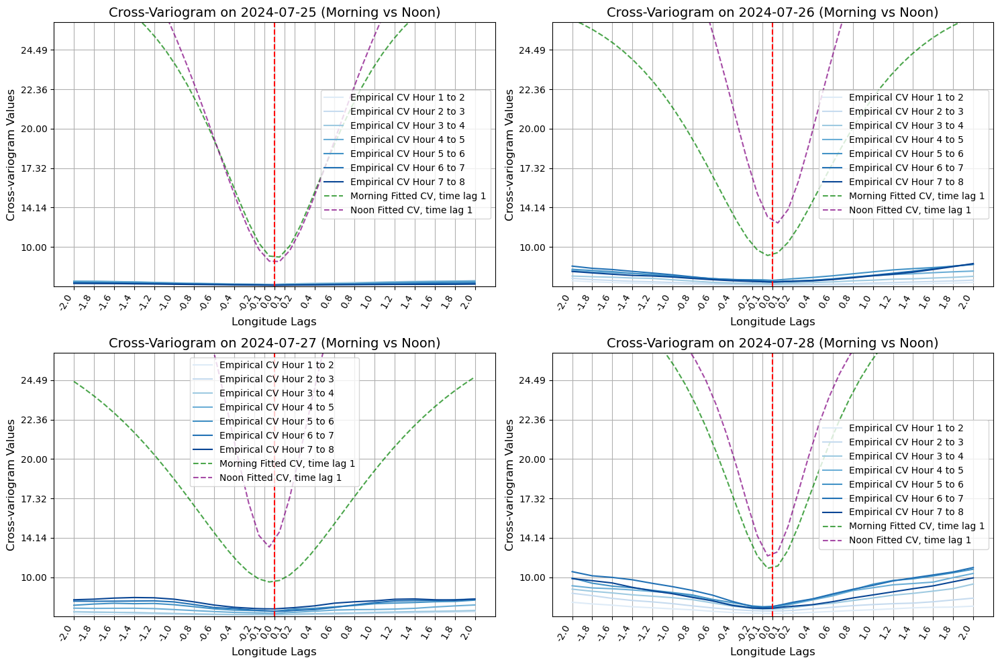

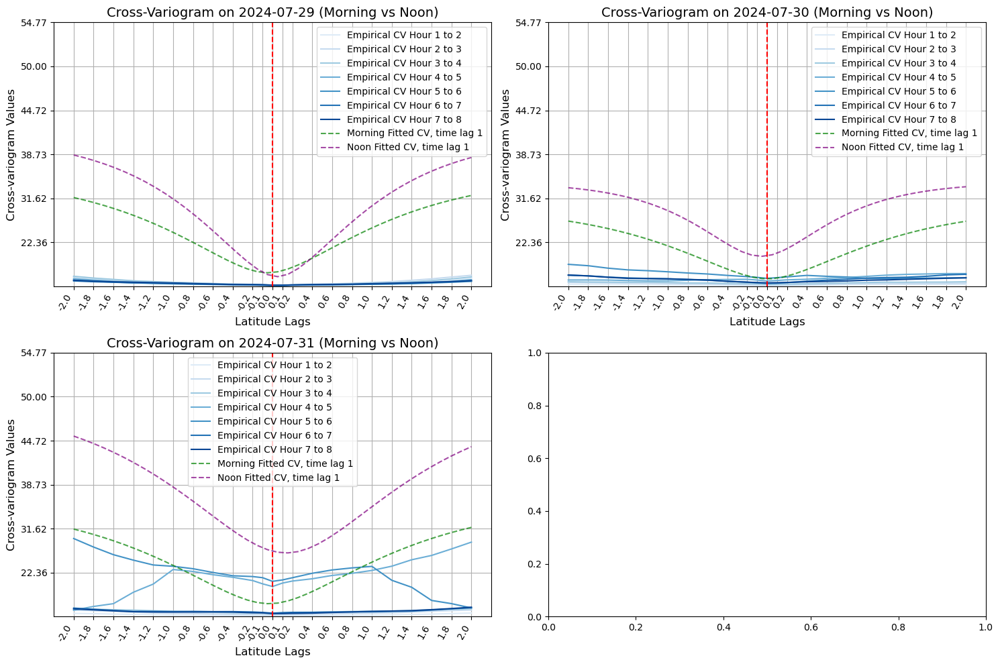

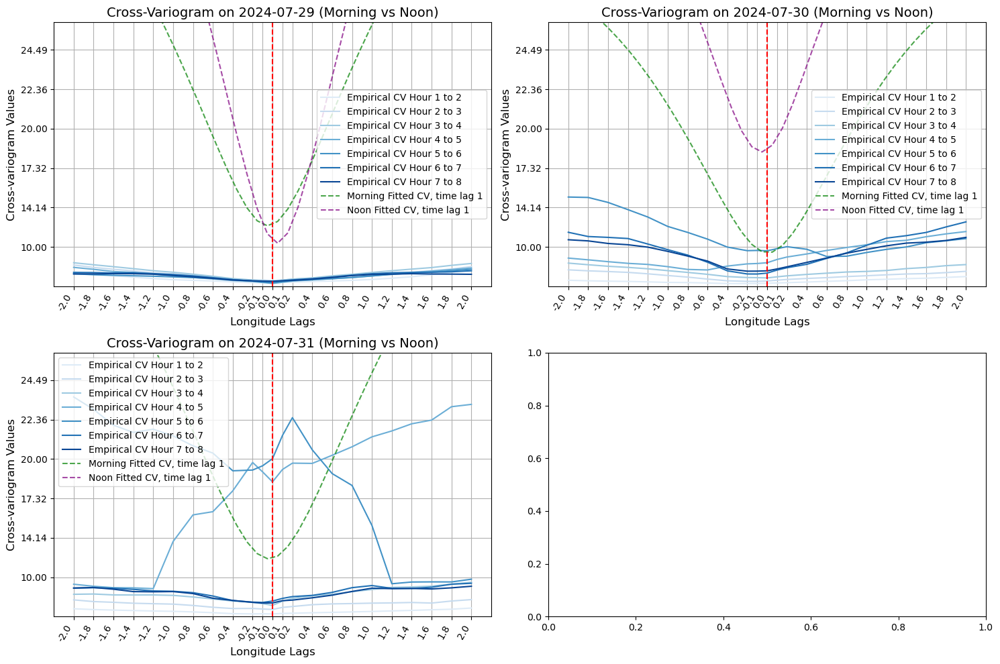

In [29]:
save_path = "C:\\Users\\joonw\\tco\\GEMS_TCO-2\\plots\\directional_semivariograms\\tmp_save"


length_of_analysis = 'Morning vs Noon'
instance_sem = CrossVariogram(save_path, length_of_analysis)

# x_values = [-1, -.8, -.6, -.4, -.2, 0, 0.2, 0.4, 0.6, 0.8, 1]
dayss = [[1,2,3,4], [5,6,7,8], [9,10,11,12], [13,14,15,16], [17,18,19,20], [21,22,23,24], [25,26,27,28], [29,30,31]]
x_values = np.concatenate((np.linspace(-2, -0.2, 10), [-0.1, 0, 0.1], np.linspace(0.2, 2, 10)))

# dayss = [[1,2]]

for days in dayss:

    tmp = np.concatenate((np.linspace(-2, -0.2, 10), [-0.1, 0, 0.1], np.linspace(0.2, 2, 10)))
    tolerance = 0.02

    # latitude direction
    deltas = [ (round(a,1),0 ) for a in tmp]
    instance_sem.plot_two_latitude(days, d_lat_20000, deltas, morning_v15_1250, noon_v15_1250)

    # longitude direction
    deltas_lon = [ (0, round(a,1)) for a in tmp]
    instance_sem.plot_two_longitude(days, d_lon_20000, deltas_lon, morning_v15_1250, noon_v15_1250)
 

quarterday

In [ ]:
# quart_v05_1250 = pd.read_csv("C:\\Users\\joonw\\tco\\GEMS_TCO-2\\Exercises\\from_amarel\\full_v15_1250.0.csv")

quart_v05_1250 = quart_v05_1250[['sigma', 'range_lat', 'range_lon', 'advec_lat', 'advec_lon', 'beta', 'nugget', 'loss']]

save_path = "C:\\Users\\joonw\\tco\\GEMS_TCO-2\\plots\\directional_semivariograms\\tmp_save"
length_of_analysis = 'whole day'
instance_sem = CrossVariogram(save_path, length_of_analysis)

# x_values = [-1, -.8, -.6, -.4, -.2, 0, 0.2, 0.4, 0.6, 0.8, 1]
dayss = [[1,2,3,4], [5,6,7,8], [9,10,11,12], [13,14,15,16], [17,18,19,20], [21,22,23,24], [25,26,27,28], [29,30,31]]
x_values = np.concatenate((np.linspace(-2, -0.2, 10), [-0.1, 0, 0.1], np.linspace(0.2, 2, 10)))

# dayss = [[1,2]]

for days in dayss:

    tmp = np.concatenate((np.linspace(-2, -0.2, 10), [-0.1, 0, 0.1], np.linspace(0.2, 2, 10)))
    tolerance = 0.02

    # latitude direction
    deltas = [ (round(a,1),0 ) for a in tmp]
    instance_sem.plot_lat_emp_the( d_lat_20000,days,deltas, dfv15_1250)

    # longitude direction
    deltas = [ (0, round(a,1)) for a in tmp]
    instance_sem.plot_lon_emp_the( d_lon_20000,days,deltas, dfv15_1250)